# Deep Learning Final Project

Aryaman Shodhan ashodha1,
Trisha Karani \<JHED\>,
Shreya Wadhwa \<JHED\>,
Aidan Aug \<JHED\>

TODO: Include brief description about project

In [ ]:
## Mount Google Drive Data
try:
    from google.colab import drive
    drive.mount('/content/gdrive')
except:
    print("Mounting Failed.")

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
## Standard Library
import os
import json
import re

## External Libraries
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as functional
import matplotlib.pyplot as plt
import numpy as np
import random
from skimage import io
from skimage.color import rgb2gray
from torchvision import transforms, models
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler
import time

In [ ]:
use_gpu = torch.cuda.is_available()

# Data Preprocessing

TODO: INCLUDE THE STEPS PERFORMED FOR PREPROCESSING THE DATA

Eg. Augmentations, split into train val test, etc.

In [ ]:
# data_dir = "/content/gdrive/MyDrive/Deep_Learning/archive"
data_dir = "/content/gdrive/MyDrive/Notes/Spring 2023/Deep Learning/Deep_Learning/archive" #Shreya

data = []
for root, _, files in os.walk(data_dir):
  files = sorted(filter(lambda x: re.search("endo.png$", x) is not None, files))
  for idx in range(len(files)):
    data.append(os.path.join(root, files[idx]))

random.shuffle(data)

In [ ]:
train_range_end = int(0.8 * len(data))
val_range_end = int(0.9 * len(data))
test_range_end = int(1.0 * len(data))

train_datapoints = data[0:train_range_end]
val_datapoints = data[train_range_end:val_range_end]
test_datapoints = data[val_range_end:test_range_end]

In [ ]:
class ImageDataset(Dataset):
  def __init__(self, data, transforms=None):
    self.data = data
    self.transforms = transforms
  
  def __len__(self):
    return len(self.data)
  
  def __getitem__(self, idx):
    target = io.imread(self.data[idx])
    input = rgb2gray(target)
    if self.transforms:
      input, target = self.img_transform(input, target)
      input = input.repeat(3, 1, 1).to(torch.float32)
    return input, target

  def img_transform(self, input, target):
    input = self.transforms(input)
    target = self.transforms(target)
    return input, target

In [ ]:
train_batch_size = 10
validation_batch_size = 10
test_batch_size = 1

img_transforms = transforms.Compose([
  transforms.ToTensor(),
  transforms.Resize(size=(300, 525)),
  transforms.CenterCrop(size=256)
])

######

train_dataset = ImageDataset(data=train_datapoints, transforms=img_transforms)
val_dataset = ImageDataset(data=val_datapoints, transforms=img_transforms)
test_dataset = ImageDataset(data=test_datapoints, transforms=img_transforms)

# Train/Val Subsets
train_mask = random.sample(range(train_dataset.__len__()), 900)
val_mask = random.sample(range(val_dataset.__len__()), 150)
test_mask = random.sample(range(test_dataset.__len__()), 150)

train_dataloader = DataLoader(dataset=train_dataset, batch_size=train_batch_size, sampler=SubsetRandomSampler(train_mask))
val_dataloader = DataLoader(dataset=val_dataset, batch_size=validation_batch_size, sampler=SubsetRandomSampler(val_mask))
test_dataloader = DataLoader(dataset=test_dataset, batch_size=test_batch_size, sampler=SubsetRandomSampler(test_mask))

print(len(train_dataloader))
print(len(val_dataloader))
print(len(test_dataloader))

90
15
150


In [ ]:
def visualize_input(dataloader, n_batches=1, n_samples=1):
  pil_transform = transforms.ToPILImage()
  for _ in range(n_batches):
    inputs, targets = next(iter(dataloader))
    for i in range(n_samples): 
      input = pil_transform(inputs[i])
      target = pil_transform(targets[i])

      fig, ax = plt.subplots(1, 2, figsize=(9, 3))
      ax[0].imshow(np.asarray(input))
      ax[0].set_title("Input Grayscale Image")    

      ax[1].imshow(np.asarray(target))
      ax[1].set_title("Ground Truth Colored Image")

    plt.show()

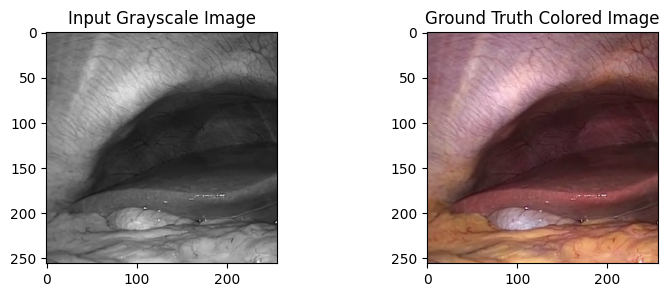

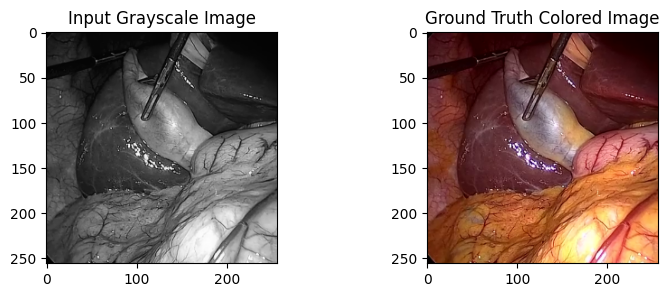

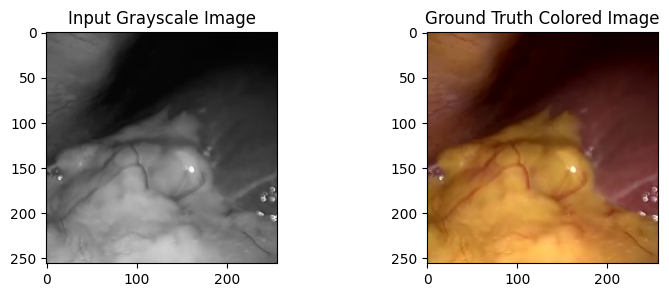

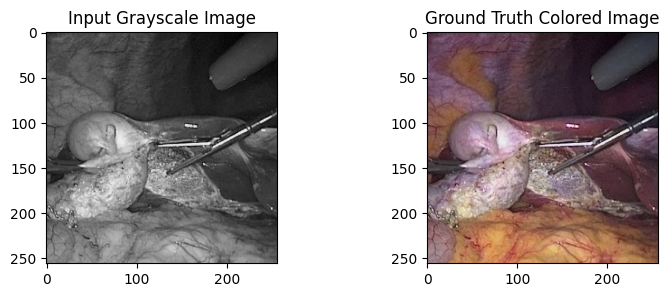

In [ ]:
visualize_input(train_dataloader, n_samples=4)

# Training and Validation

In [ ]:
def visualize_predictions(dataloader, model, n_batches=1, n_samples=1, use_gpu=False, mode="train"):
  if (mode == "test"):
    model.eval()
  with torch.no_grad():
    pil_transform = transforms.ToPILImage()
    for _ in range(n_batches):
      inputs, targets = next(iter(dataloader))

      if use_gpu:
        inputs = inputs.cuda()
        targets = targets.cuda()
      
      predictions = model(inputs)
      if (not isinstance(model, UNET)): 
        predictions = predictions['out']

      for i in range(n_samples): 
        input = pil_transform(inputs[i])
        target = pil_transform(targets[i])
        prediction = pil_transform(predictions[i])

        fig, ax = plt.subplots(1, 3, figsize=(9, 3))
        ax[0].imshow(np.asarray(input))
        ax[0].set_title("Input Grayscale Image")    

        ax[1].imshow(np.asarray(target))
        ax[1].set_title("Ground Truth Colorization")

        ax[2].imshow(np.asarray(prediction))
        ax[2].set_title("Predicted Colorization")

      plt.show()

In [ ]:
def train(model, loss_f, optimizer, scheduler, train_dataloader, val_dataloader, epochs=20, use_gpu=False, **kwargs):
  train_losses = []
  val_losses = []
  print("Start Training...")
  for epoch in range(epochs):
    print("\nEPOCH " + str(epoch + 1) + " of " + str(epochs) + "\n")

    ########################### Training #####################################
    epoch_train_loss = 0
    epoch_train_total = 0
    for i, (train_images, train_targets) in enumerate(train_dataloader):
      model.train()
      if use_gpu:
        train_images = train_images.cuda()
        train_targets = train_targets.cuda()

      if (i > 0 or epoch > 0):
        optimizer.zero_grad()
      
      train_predictions = model(train_images)
      if (not isinstance(model, UNET)):
        train_predictions = train_predictions['out']

      train_loss = loss_f.forward(train_predictions, train_targets)
      train_loss.backward()

      epoch_train_loss += train_loss.item()
      epoch_train_total += train_targets.shape[0]

      optimizer.step()
    
    train_losses.append(epoch_train_loss / epoch_train_total)

    ########################### Validation #####################################
    epoch_val_loss = 0
    epoch_val_total = 0
    for val_images, val_targets in val_dataloader:

      if use_gpu:
        val_images = val_images.cuda()
        val_targets = val_targets.cuda()
      
      val_predictions = model(val_images)
      if (not isinstance(model, UNET)):
        val_predictions = val_predictions['out']

      val_loss = loss_f.forward(val_predictions, val_targets)

      epoch_val_loss += val_loss.item()
      epoch_val_total += val_targets.shape[0]
    
    val_losses.append(epoch_val_loss / epoch_val_total)

    scheduler.step()

    print("Training loss: %f" % (epoch_train_loss / epoch_train_total))
    print("Validation loss: %f" % (epoch_val_loss / epoch_val_total))
    visualize_predictions(train_dataloader, model, use_gpu=use_gpu)

  plt.figure()
  plt.plot(train_losses, label="Training")
  plt.plot(val_losses, label="Validation")
  plt.xlabel("Epochs")
  plt.ylabel("Loss")
  plt.legend(loc="upper right")

## UNET

In [ ]:
def add_conv_stage(dim_in, dim_out, kernel_size=3, stride=1, padding=1, bias=True, useBN=True):
  if useBN:
    return nn.Sequential(
        nn.Conv2d(dim_in, dim_out, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
        nn.BatchNorm2d(dim_out),
        nn.LeakyReLU(0.1),
        nn.Conv2d(dim_out, dim_out, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
        nn.BatchNorm2d(dim_out),
        nn.LeakyReLU(0.1)
    )
  return nn.Sequential(
      nn.Conv2d(dim_in, dim_out, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
      nn.ReLU(),
      nn.Conv2d(dim_out, dim_out, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
      nn.ReLU()
  )

def upsample(ch_coarse, ch_fine):
  return nn.Sequential(
      nn.ConvTranspose2d(ch_coarse, ch_fine, kernel_size=4, stride=2, padding=1, bias=False),
      nn.ReLU()
  )

In [ ]:
class UNET(nn.Module):

  def __init__(self, n_classes, useBN=True):
    super(UNET, self).__init__()
    # Downgrade Stages
    self.conv1 = add_conv_stage(dim_in=3, dim_out=32, useBN=useBN)
    self.conv2 = add_conv_stage(dim_in=32, dim_out=64, useBN=useBN)
    self.conv3 = add_conv_stage(dim_in=64, dim_out=128, useBN=useBN)
    self.conv4 = add_conv_stage(dim_in=128, dim_out=256, useBN=useBN)

    # Upgrade Stages
    self.conv3m = add_conv_stage(dim_in=256, dim_out=128, useBN=useBN)
    self.conv2m = add_conv_stage(dim_in=128, dim_out=64, useBN=useBN)
    self.conv1m = add_conv_stage(dim_in=64, dim_out=32, useBN=useBN)

    # Maxpool
    self.max_pool = nn.MaxPool2d(kernel_size=2)

    # Upsample Layers
    self.upsample43 = upsample(ch_coarse=256, ch_fine=128)
    self.upsample32 = upsample(ch_coarse=128, ch_fine=64)
    self.upsample21 = upsample(ch_coarse=64, ch_fine=32)

    # Final Layer
    self.conv1x1 = add_conv_stage(dim_in=32, dim_out=n_classes, kernel_size=1, padding=0, useBN=useBN)

  def forward(self, x):
    conv1_out = self.conv1(x)
    conv2_out = self.conv2(self.max_pool(conv1_out))
    conv3_out = self.conv3(self.max_pool(conv2_out))
    conv4_out = self.conv4(self.max_pool(conv3_out))

    conv4m_out_ = torch.cat((self.upsample43(conv4_out), conv3_out), dim=1)
    conv3m_out = self.conv3m(conv4m_out_)

    conv3m_out_ = torch.cat((self.upsample32(conv3m_out), conv2_out), dim=1)
    conv2m_out = self.conv2m(conv3m_out_)

    conv2m_out_ = torch.cat((self.upsample21(conv2m_out), conv1_out), dim=1)
    conv1m_out = self.conv1m(conv2m_out_)

    conv_out = self.conv1x1(conv1m_out)

    return conv_out

In [ ]:
n_classes = 3
lr = 0.001
epochs = 50

model = UNET(n_classes=n_classes)
if use_gpu:
  model = model.cuda()

for m in model.modules():
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    if m.bias is not None:
      m.bias.data.zero_()

print(model.parameters)

loss_f = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

<bound method Module.parameters of UNET(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
  )
  (conv2): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
  )
  (conv3): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1,

Start Training...

EPOCH 1 of 50

Training loss: 0.017757
Validation loss: 0.005301


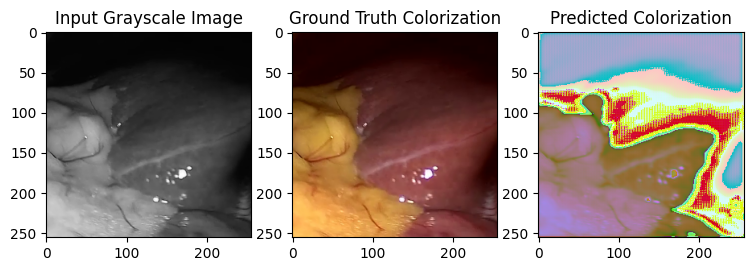


EPOCH 2 of 50

Training loss: 0.004120
Validation loss: 0.003178


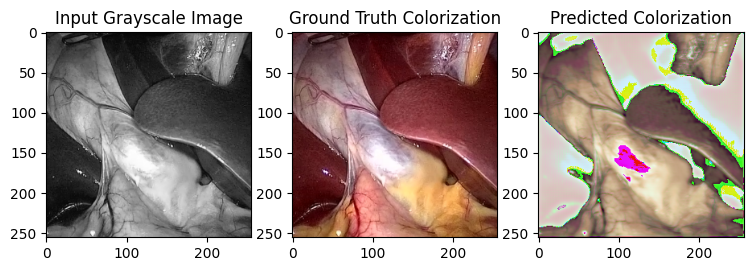


EPOCH 3 of 50

Training loss: 0.002917
Validation loss: 0.002660


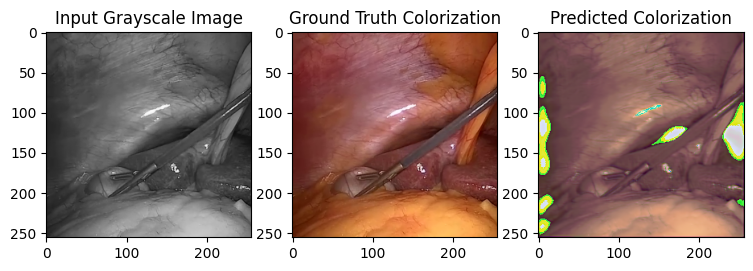


EPOCH 4 of 50

Training loss: 0.002445
Validation loss: 0.002269


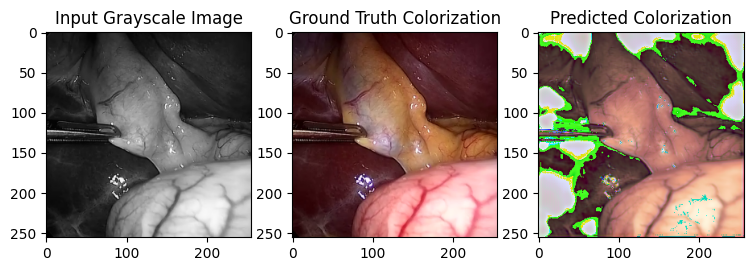


EPOCH 5 of 50

Training loss: 0.002162
Validation loss: 0.001984


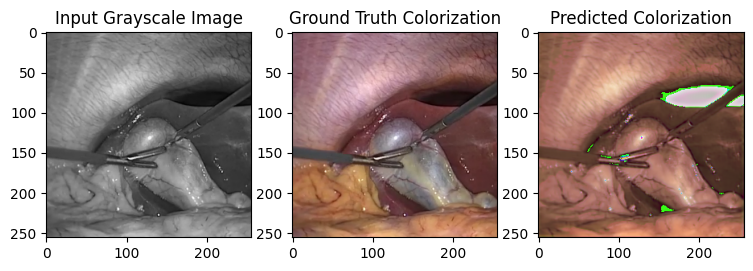


EPOCH 6 of 50

Training loss: 0.001947
Validation loss: 0.001965


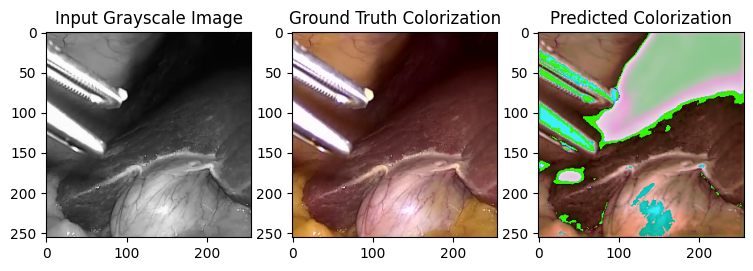


EPOCH 7 of 50

Training loss: 0.001798
Validation loss: 0.001689


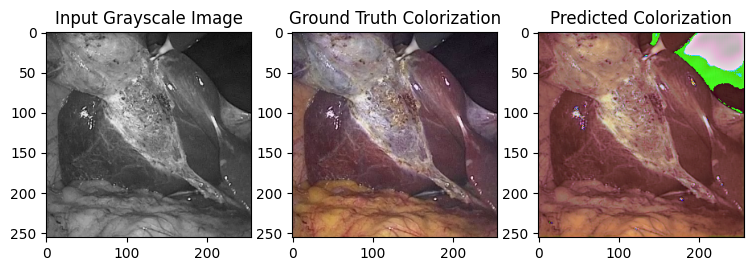


EPOCH 8 of 50

Training loss: 0.001597
Validation loss: 0.001530


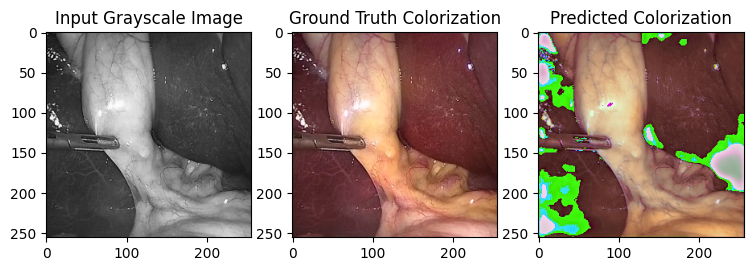


EPOCH 9 of 50

Training loss: 0.001472
Validation loss: 0.001388


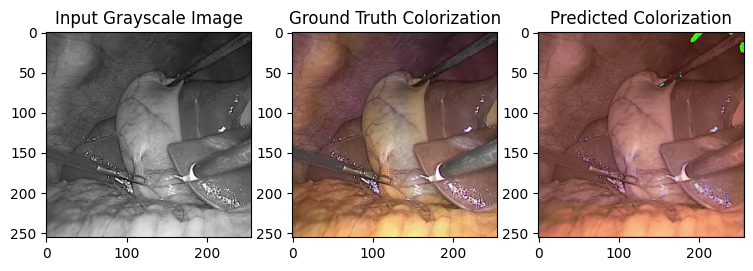


EPOCH 10 of 50

Training loss: 0.001363
Validation loss: 0.001353


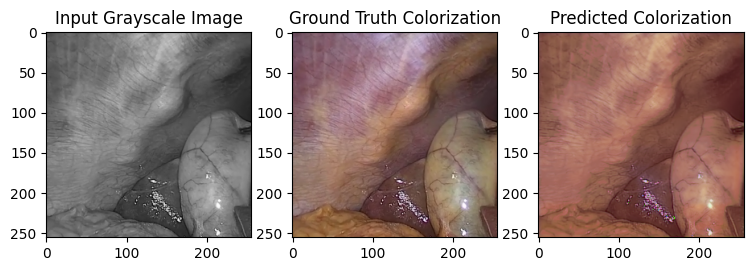


EPOCH 11 of 50

Training loss: 0.001281
Validation loss: 0.001226


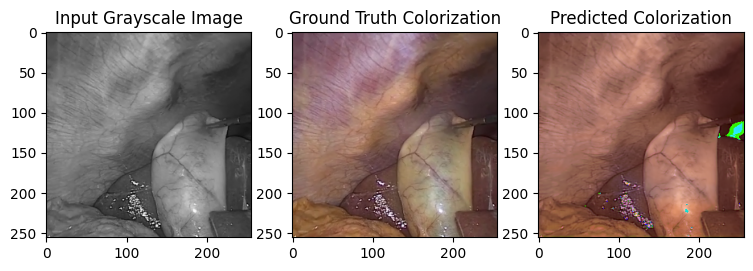


EPOCH 12 of 50

Training loss: 0.001241
Validation loss: 0.001201


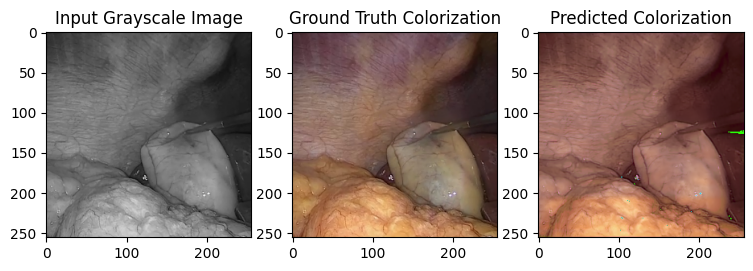


EPOCH 13 of 50

Training loss: 0.001199
Validation loss: 0.001205


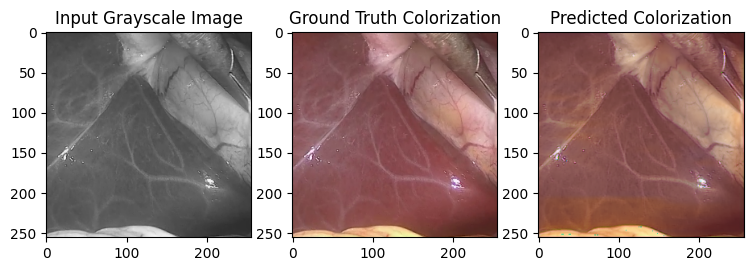


EPOCH 14 of 50

Training loss: 0.001192
Validation loss: 0.001187


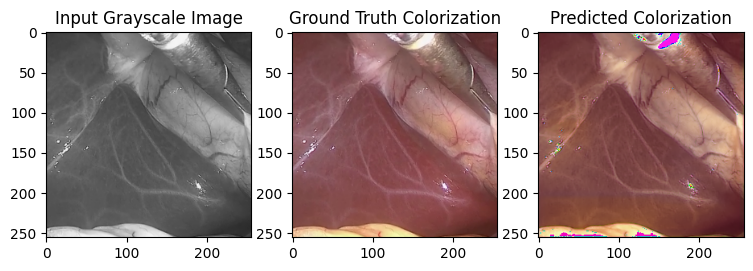


EPOCH 15 of 50

Training loss: 0.001186
Validation loss: 0.001188


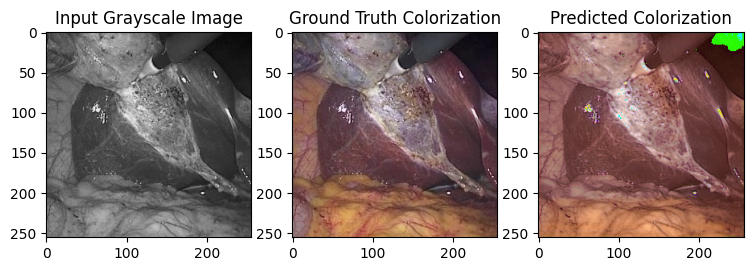


EPOCH 16 of 50

Training loss: 0.001175
Validation loss: 0.001151


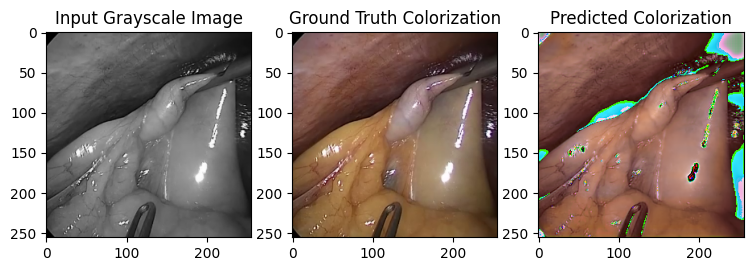


EPOCH 17 of 50

Training loss: 0.001142
Validation loss: 0.001171


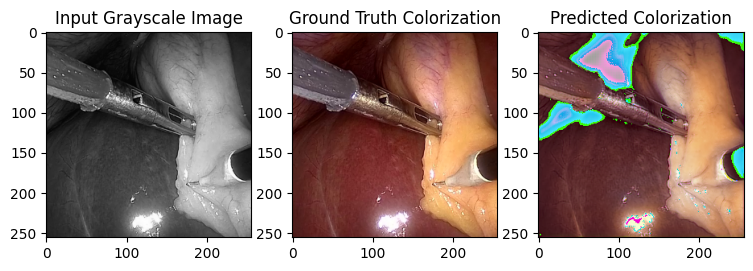


EPOCH 18 of 50

Training loss: 0.001137
Validation loss: 0.001128


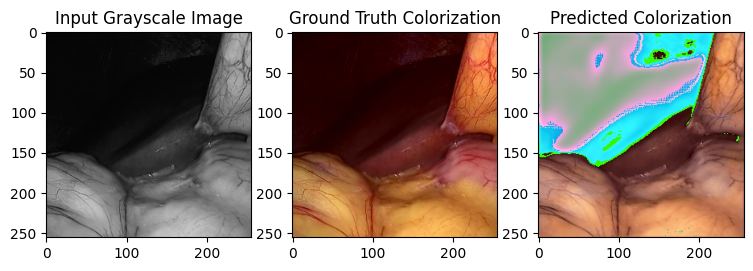


EPOCH 19 of 50

Training loss: 0.001112
Validation loss: 0.001116


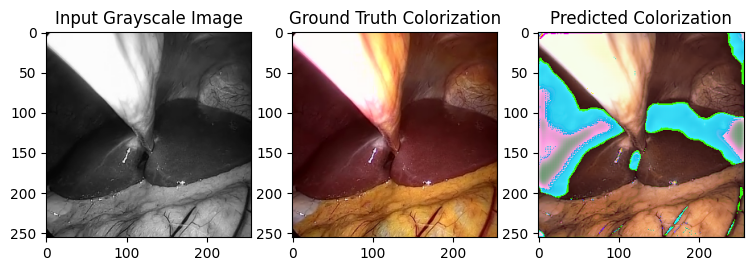


EPOCH 20 of 50

Training loss: 0.001112
Validation loss: 0.001113


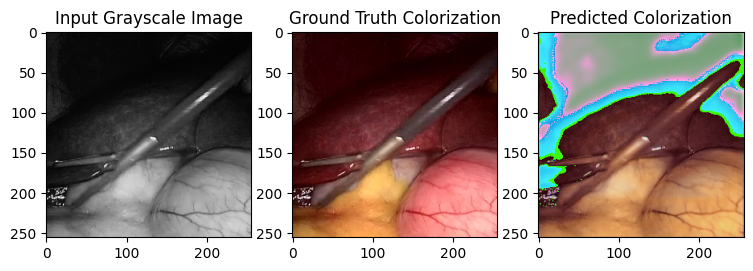


EPOCH 21 of 50

Training loss: 0.001090
Validation loss: 0.001095


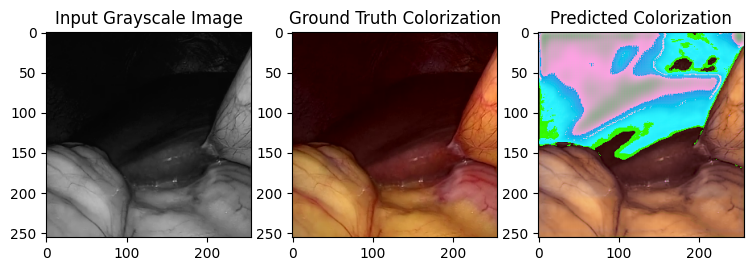


EPOCH 22 of 50

Training loss: 0.001090
Validation loss: 0.001103


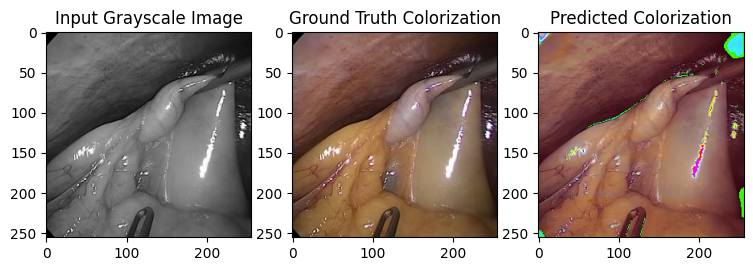


EPOCH 23 of 50

Training loss: 0.001085
Validation loss: 0.001107


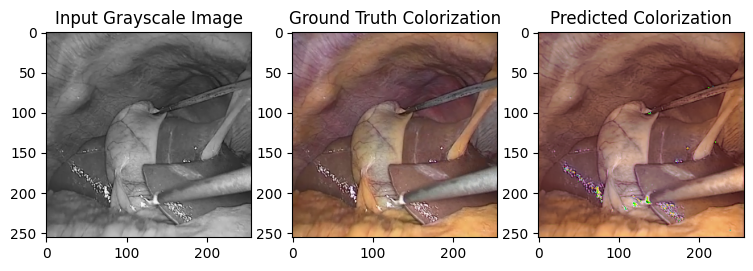


EPOCH 24 of 50

Training loss: 0.001075
Validation loss: 0.001114


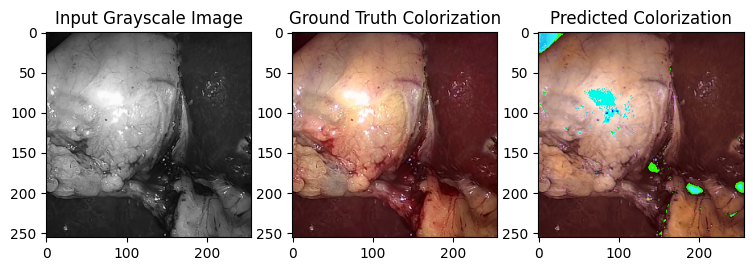


EPOCH 25 of 50

Training loss: 0.001082
Validation loss: 0.001117


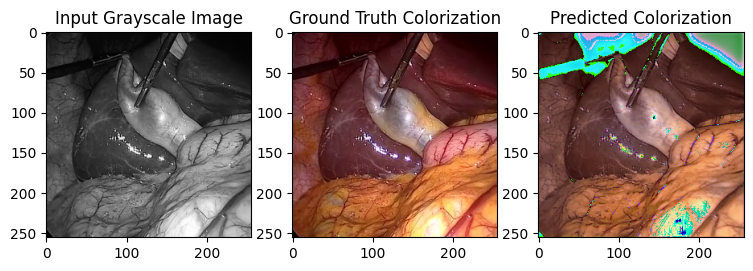


EPOCH 26 of 50

Training loss: 0.001076
Validation loss: 0.001081


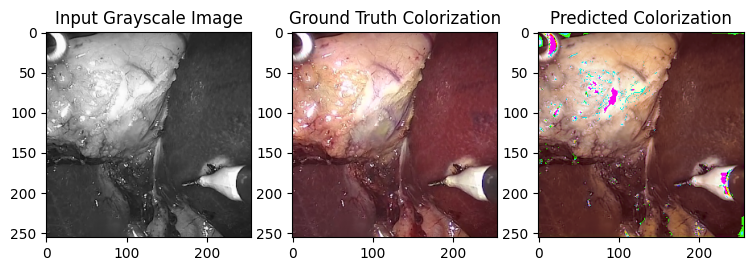


EPOCH 27 of 50

Training loss: 0.001072
Validation loss: 0.001074


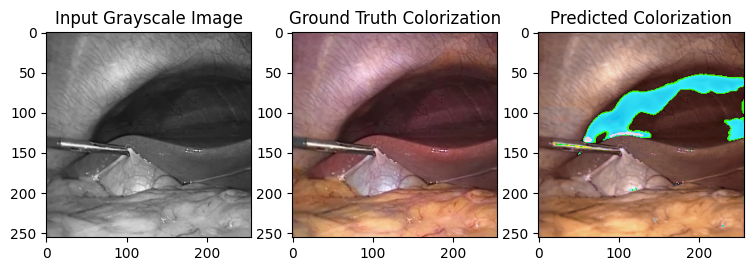


EPOCH 28 of 50

Training loss: 0.001074
Validation loss: 0.001077


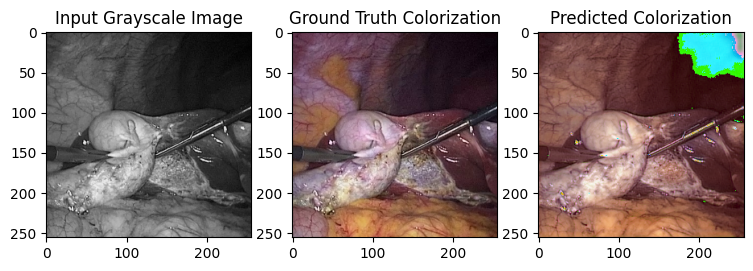


EPOCH 29 of 50

Training loss: 0.001077
Validation loss: 0.001090


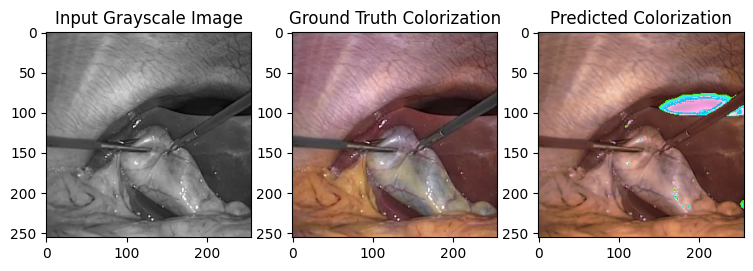


EPOCH 30 of 50

Training loss: 0.001076
Validation loss: 0.001075


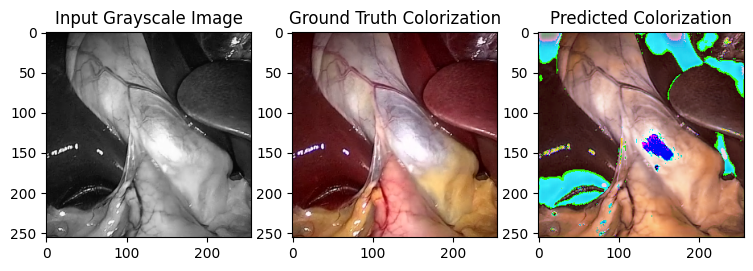


EPOCH 31 of 50

Training loss: 0.001075
Validation loss: 0.001071


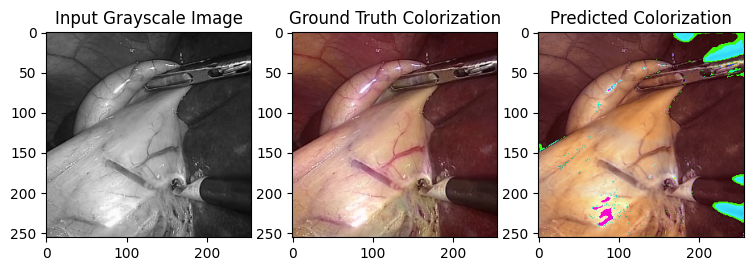


EPOCH 32 of 50

Training loss: 0.001068
Validation loss: 0.001083


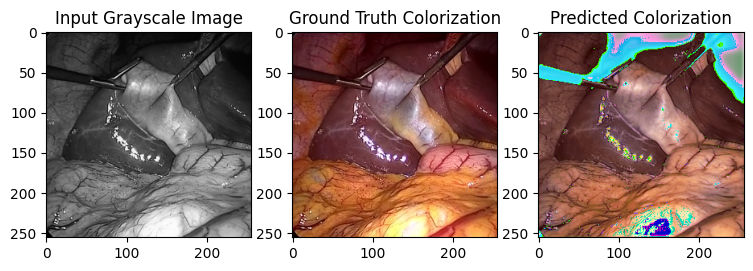


EPOCH 33 of 50

Training loss: 0.001069
Validation loss: 0.001072


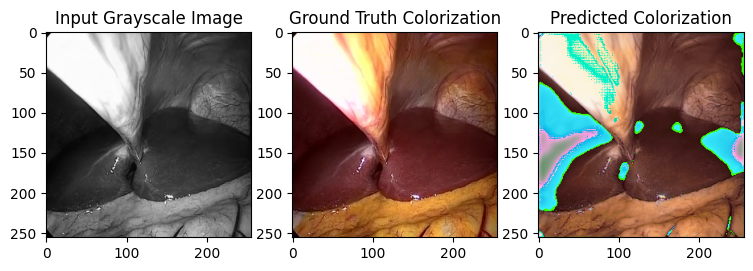


EPOCH 34 of 50

Training loss: 0.001072
Validation loss: 0.001097


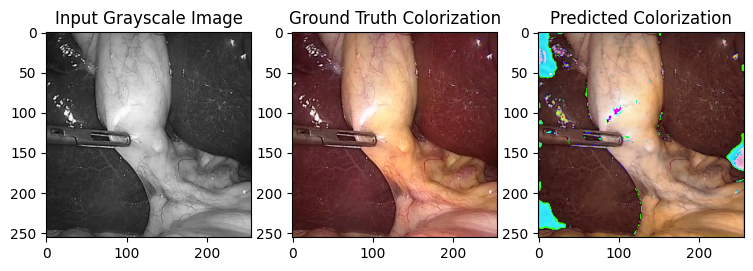


EPOCH 35 of 50

Training loss: 0.001064
Validation loss: 0.001074


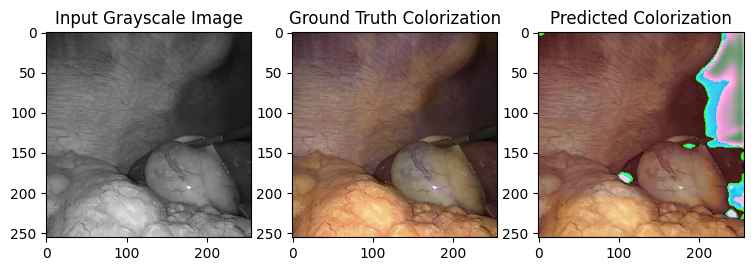


EPOCH 36 of 50

Training loss: 0.001074
Validation loss: 0.001111


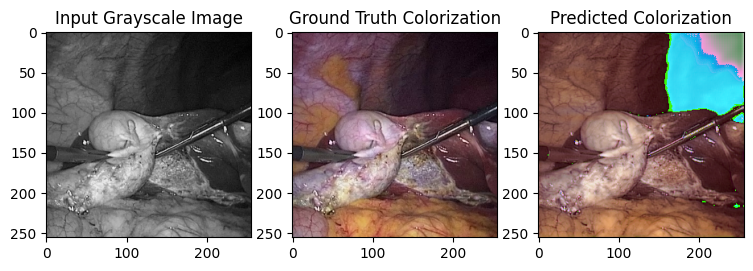


EPOCH 37 of 50

Training loss: 0.001053
Validation loss: 0.001088


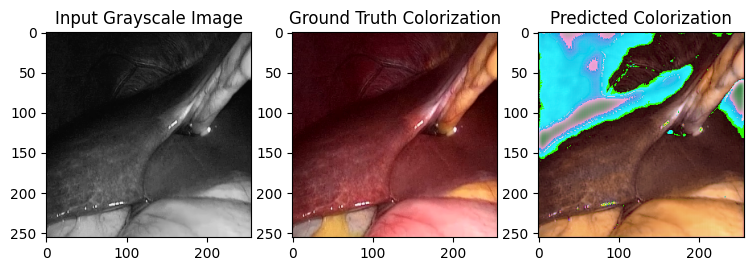


EPOCH 38 of 50

Training loss: 0.001072
Validation loss: 0.001074


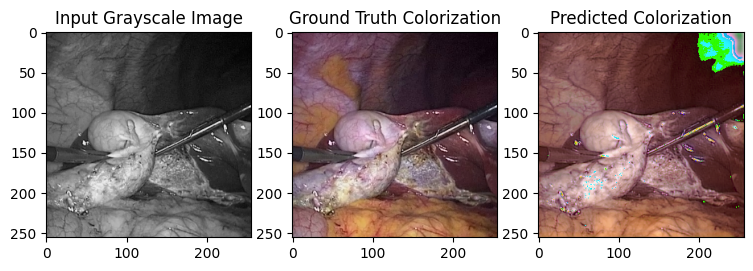


EPOCH 39 of 50

Training loss: 0.001063
Validation loss: 0.001083


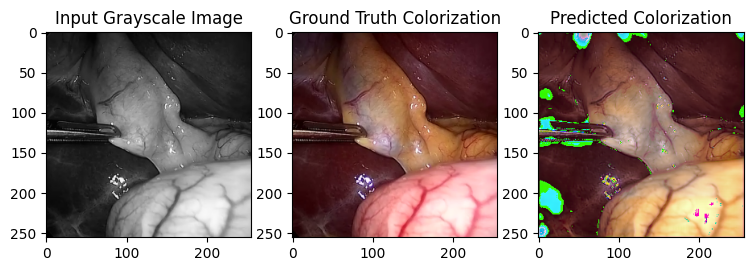


EPOCH 40 of 50

Training loss: 0.001068
Validation loss: 0.001103


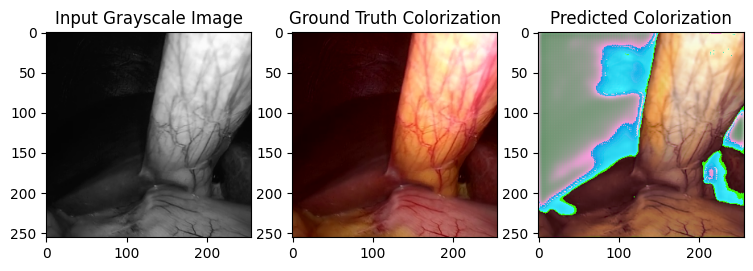


EPOCH 41 of 50

Training loss: 0.001076
Validation loss: 0.001072


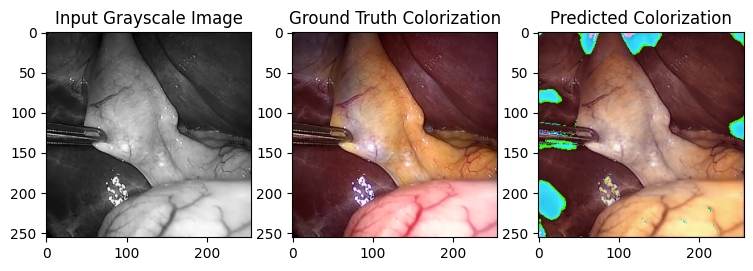


EPOCH 42 of 50

Training loss: 0.001084
Validation loss: 0.001070


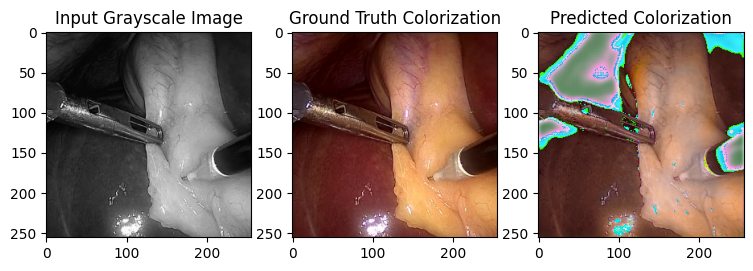


EPOCH 43 of 50

Training loss: 0.001073
Validation loss: 0.001091


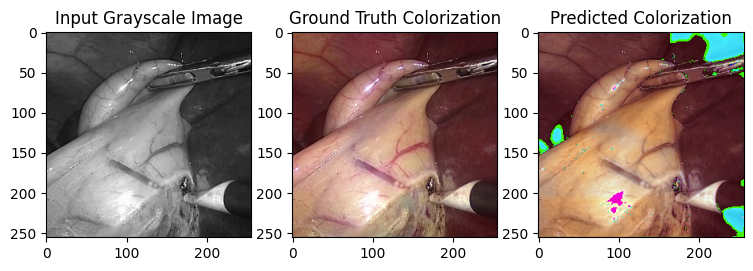


EPOCH 44 of 50

Training loss: 0.001062
Validation loss: 0.001098


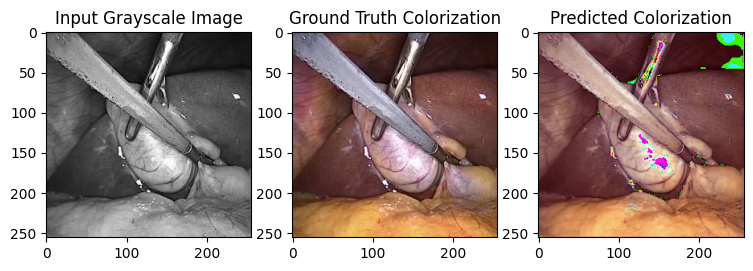


EPOCH 45 of 50

Training loss: 0.001058
Validation loss: 0.001076


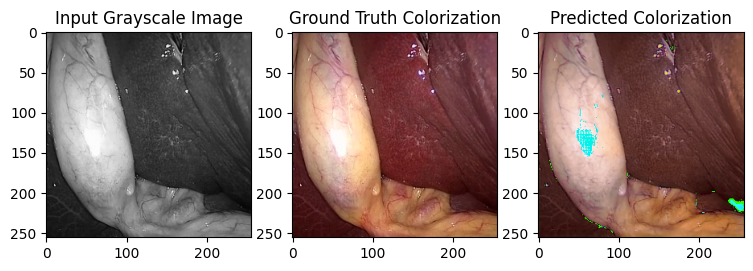


EPOCH 46 of 50

Training loss: 0.001061
Validation loss: 0.001079


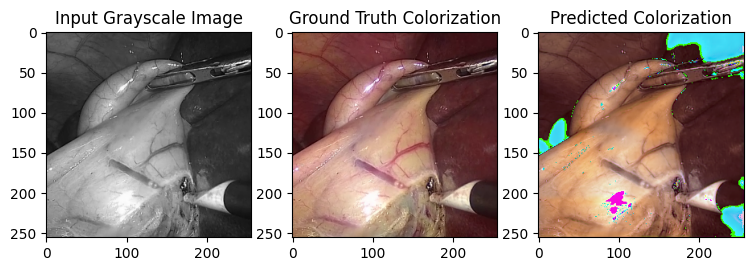


EPOCH 47 of 50

Training loss: 0.001067
Validation loss: 0.001075


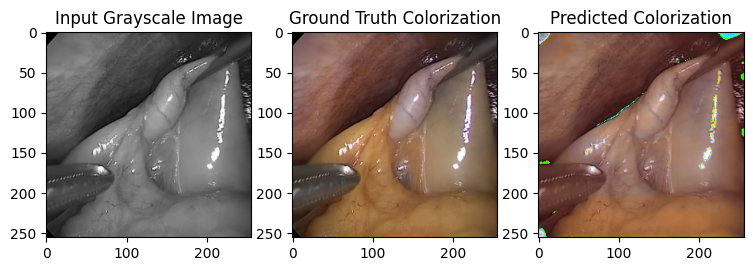


EPOCH 48 of 50

Training loss: 0.001066
Validation loss: 0.001096


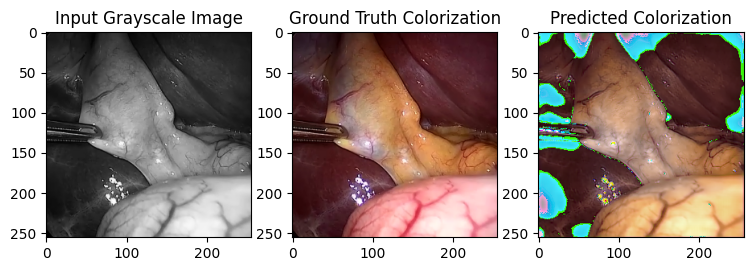


EPOCH 49 of 50

Training loss: 0.001069
Validation loss: 0.001106


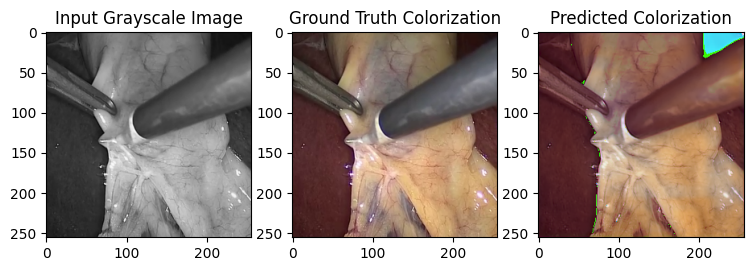


EPOCH 50 of 50

Training loss: 0.001066
Validation loss: 0.001066


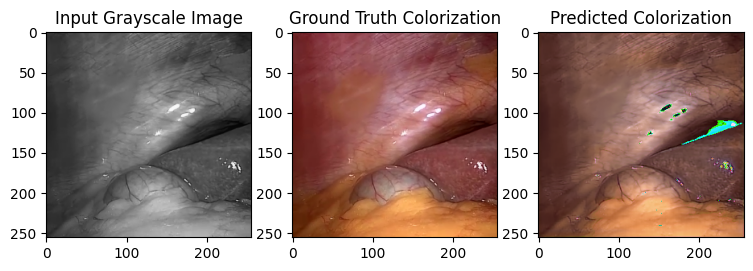

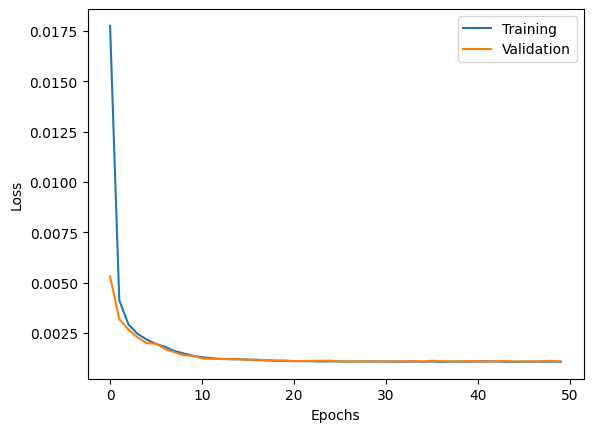

In [ ]:
train(model, loss_f, optimizer, scheduler, train_dataloader, val_dataloader, epochs=epochs, use_gpu=use_gpu)

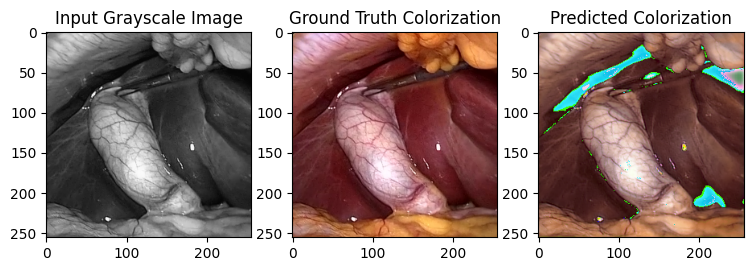

In [ ]:
visualize_predictions(test_dataloader, model, n_batches=1, use_gpu=use_gpu, mode="test")

In [ ]:
torch.save(model, "/content/gdrive/MyDrive/Deep_Learning/saved_models/models/unet_image_recolorization.pt")

## DeepLabV3

In [ ]:
n_classes = 3
lr = 0.001
epochs = 50

model = torchvision.models.segmentation.deeplabv3_resnet50()
model.classifier[4] = nn.Conv2d(256, n_classes, kernel_size=1, stride=1)

if use_gpu:
  model = model.cuda()

for m in model.modules():
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    if m.bias is not None:
      m.bias.data.zero_()

print(model.parameters)

loss_f = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

<bound method Module.parameters of DeepLabV3(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inp

Start Training...

EPOCH 1 of 50

Training loss: 0.006134
Validation loss: 0.001117


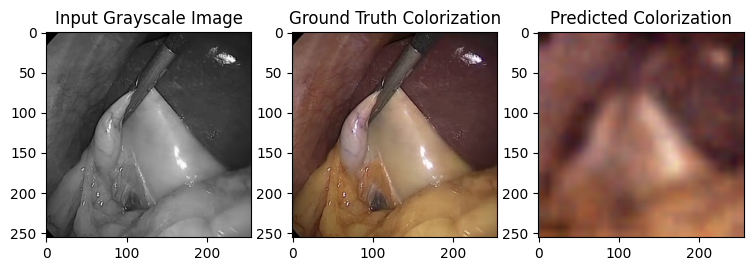


EPOCH 2 of 50

Training loss: 0.001024
Validation loss: 0.000870


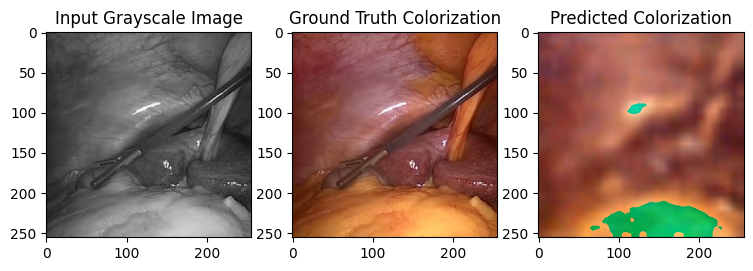


EPOCH 3 of 50

Training loss: 0.000784
Validation loss: 0.000711


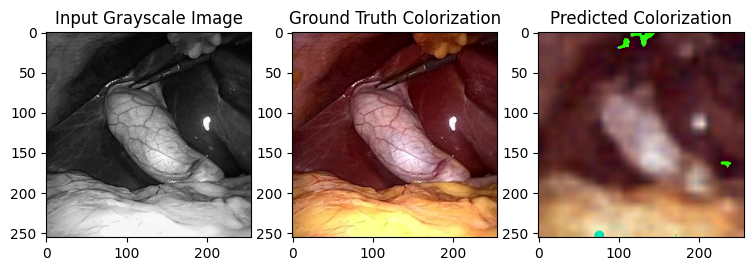


EPOCH 4 of 50

Training loss: 0.000710
Validation loss: 0.000666


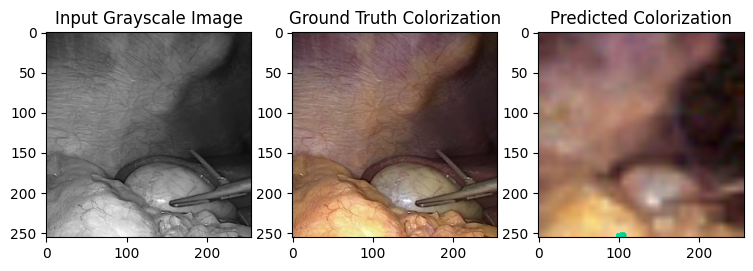


EPOCH 5 of 50

Training loss: 0.000670
Validation loss: 0.000632


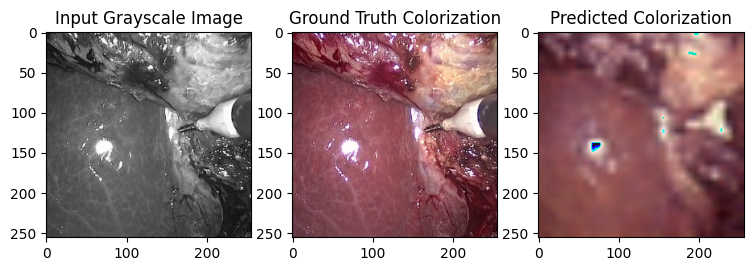


EPOCH 6 of 50

Training loss: 0.000596
Validation loss: 0.000540


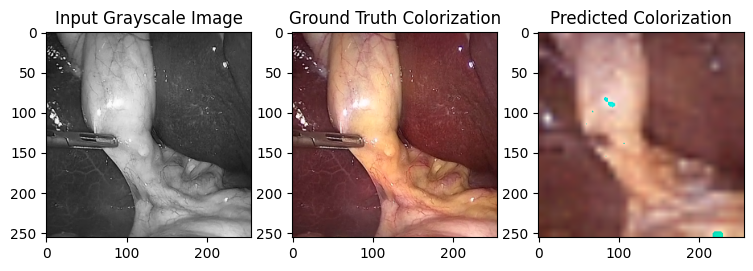


EPOCH 7 of 50

Training loss: 0.000552
Validation loss: 0.000531


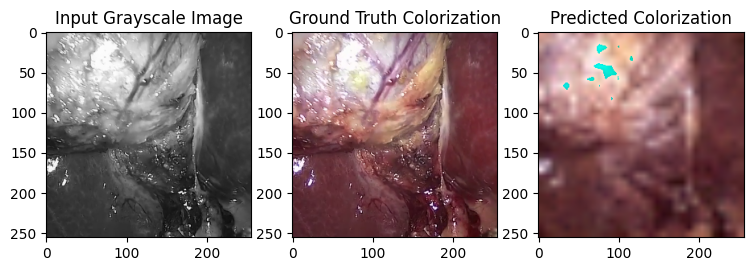


EPOCH 8 of 50

Training loss: 0.000612
Validation loss: 0.000707


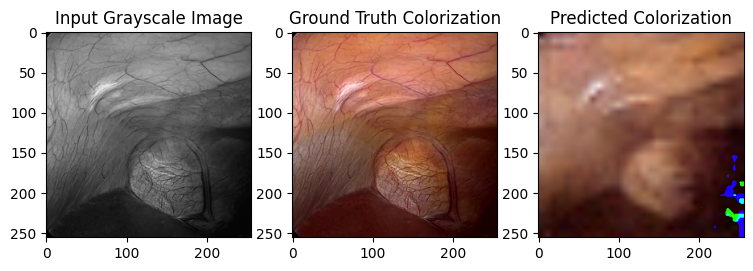


EPOCH 9 of 50

Training loss: 0.000619
Validation loss: 0.000568


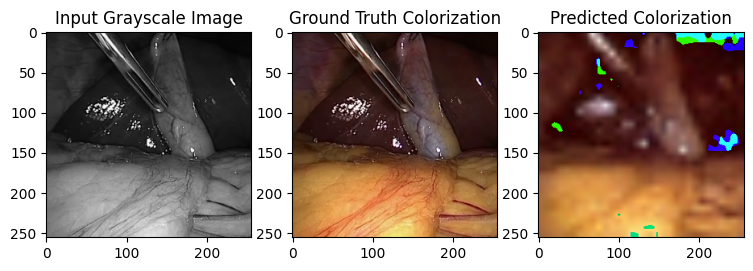


EPOCH 10 of 50

Training loss: 0.000550
Validation loss: 0.000554


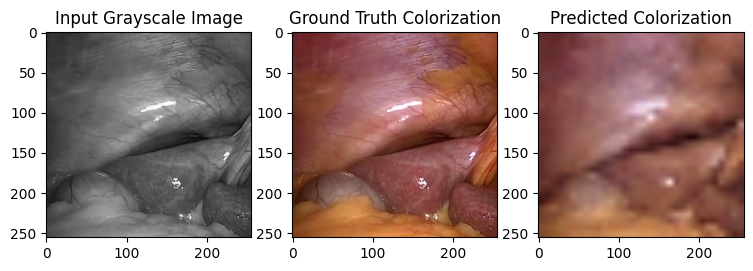


EPOCH 11 of 50

Training loss: 0.000508
Validation loss: 0.000472


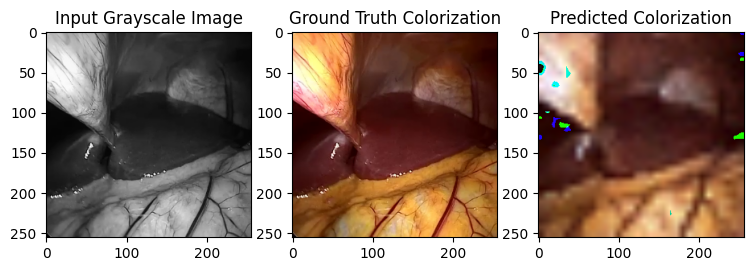


EPOCH 12 of 50

Training loss: 0.000473
Validation loss: 0.000459


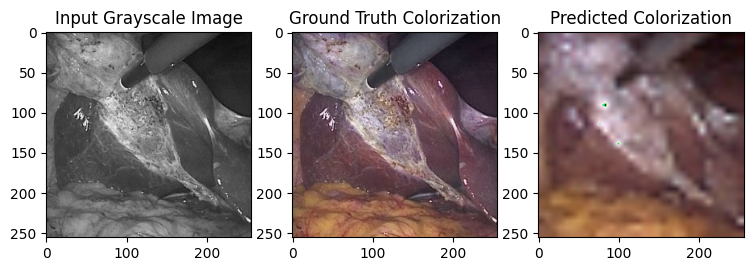


EPOCH 13 of 50

Training loss: 0.000456
Validation loss: 0.000465


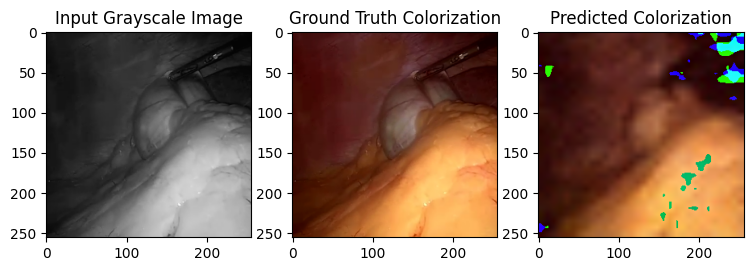


EPOCH 14 of 50

Training loss: 0.000461
Validation loss: 0.000441


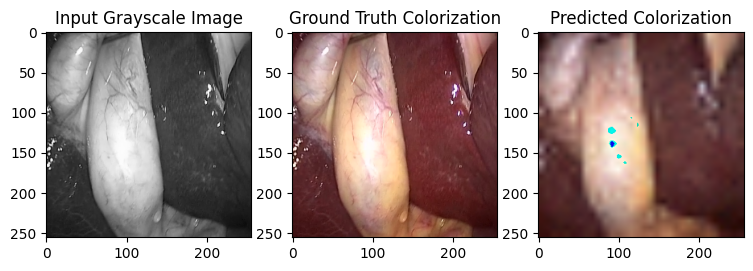


EPOCH 15 of 50

Training loss: 0.000456
Validation loss: 0.000451


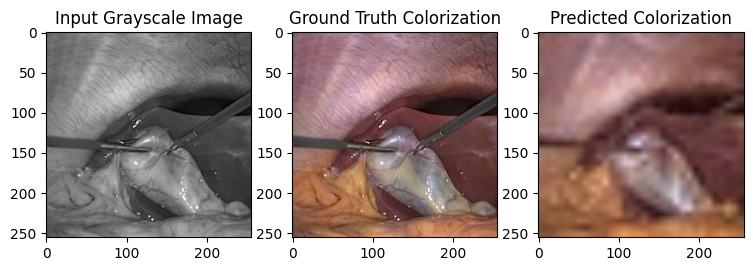


EPOCH 16 of 50

Training loss: 0.000449
Validation loss: 0.000454


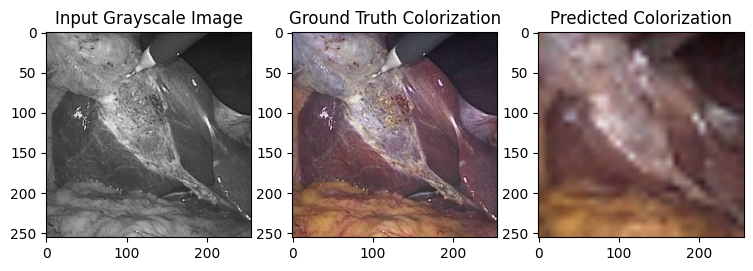


EPOCH 17 of 50

Training loss: 0.000448
Validation loss: 0.000441


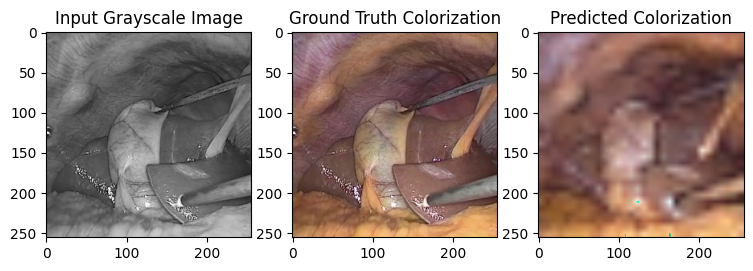


EPOCH 18 of 50

Training loss: 0.000439
Validation loss: 0.000443


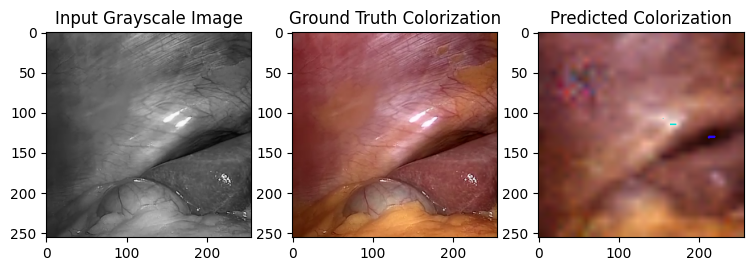


EPOCH 19 of 50

Training loss: 0.000442
Validation loss: 0.000426


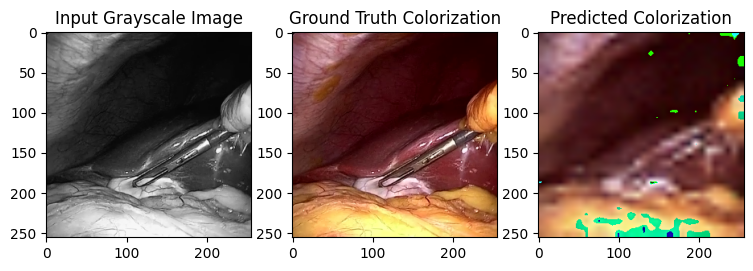


EPOCH 20 of 50

Training loss: 0.000438
Validation loss: 0.000431


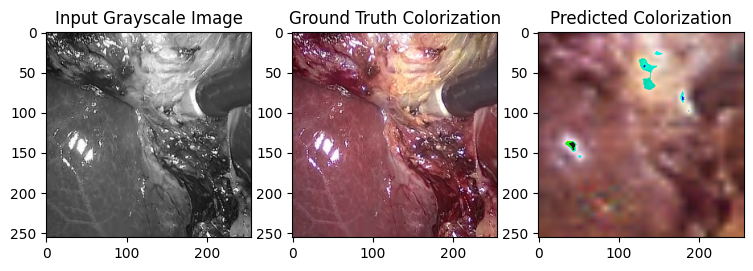


EPOCH 21 of 50

Training loss: 0.000428
Validation loss: 0.000440


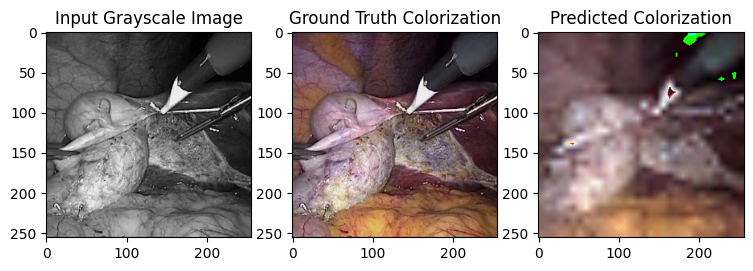


EPOCH 22 of 50

Training loss: 0.000427
Validation loss: 0.000419


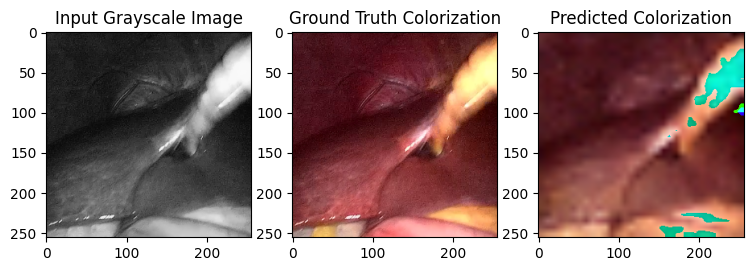


EPOCH 23 of 50

Training loss: 0.000419
Validation loss: 0.000423


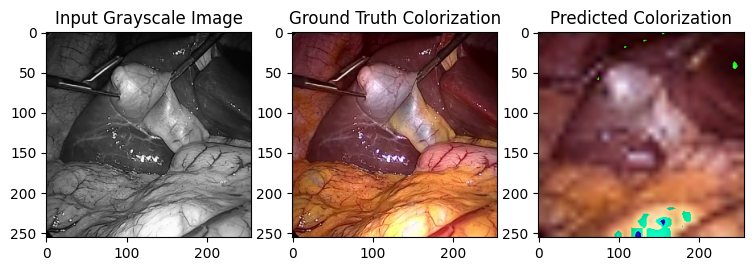


EPOCH 24 of 50

Training loss: 0.000424
Validation loss: 0.000424


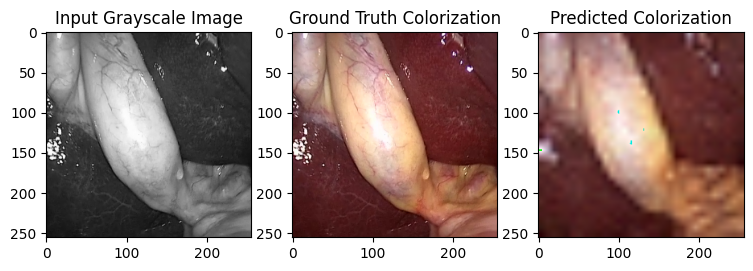


EPOCH 25 of 50

Training loss: 0.000424
Validation loss: 0.000428


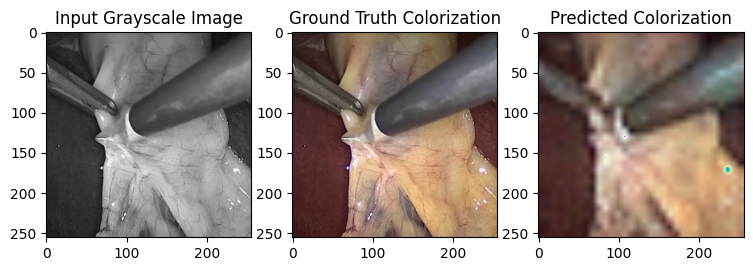


EPOCH 26 of 50

Training loss: 0.000417
Validation loss: 0.000424


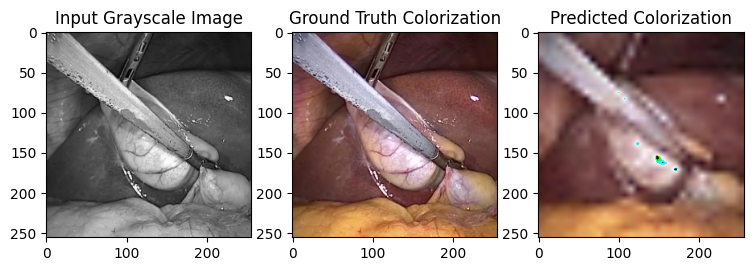


EPOCH 27 of 50

Training loss: 0.000421
Validation loss: 0.000417


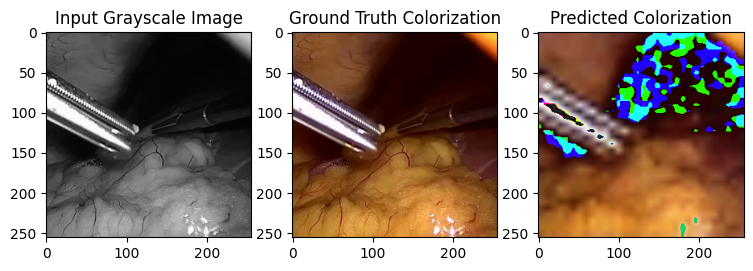


EPOCH 28 of 50

Training loss: 0.000421
Validation loss: 0.000414


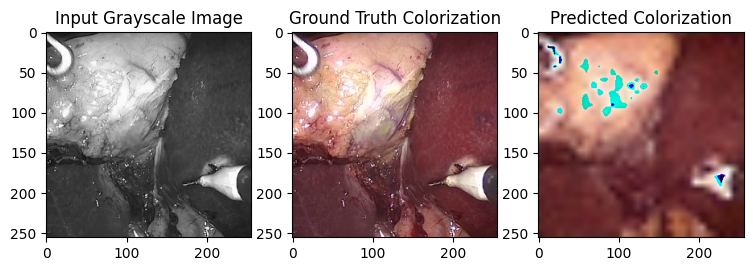


EPOCH 29 of 50

Training loss: 0.000424
Validation loss: 0.000411


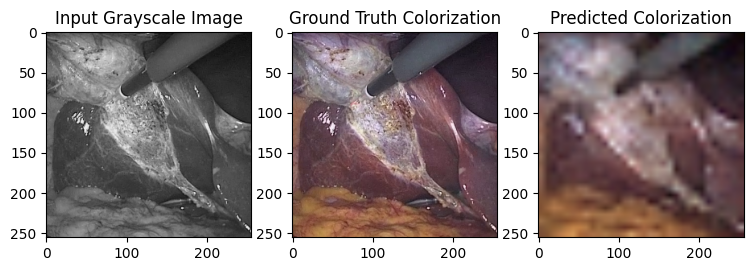


EPOCH 30 of 50

Training loss: 0.000418
Validation loss: 0.000421


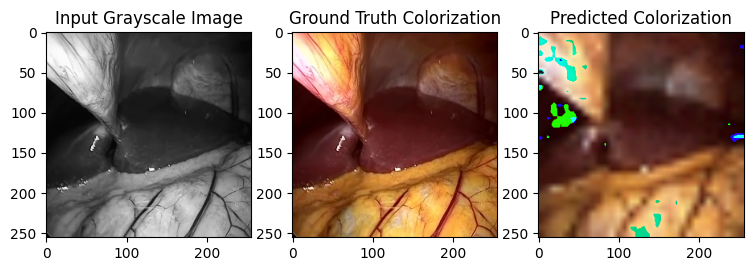


EPOCH 31 of 50

Training loss: 0.000417
Validation loss: 0.000416


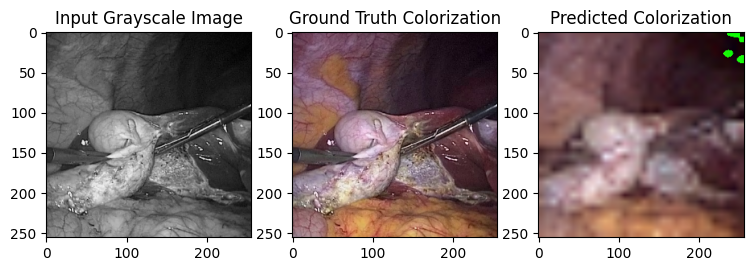


EPOCH 32 of 50

Training loss: 0.000418
Validation loss: 0.000416


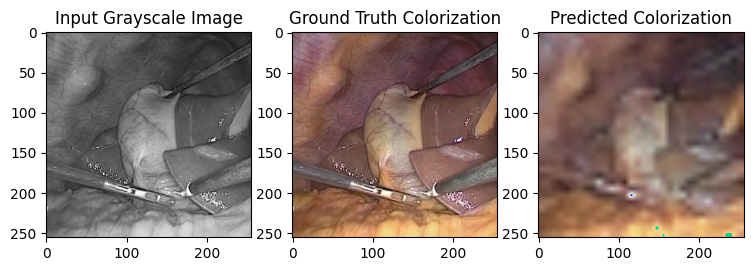


EPOCH 33 of 50

Training loss: 0.000417
Validation loss: 0.000416


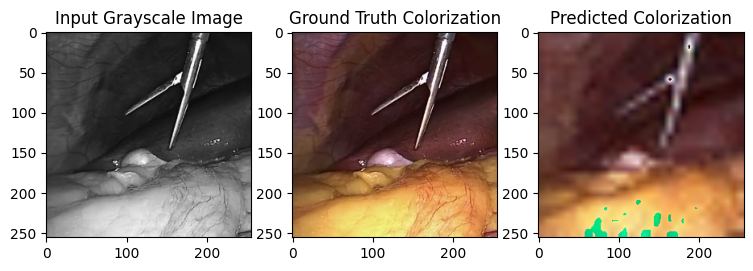


EPOCH 34 of 50

Training loss: 0.000415
Validation loss: 0.000437


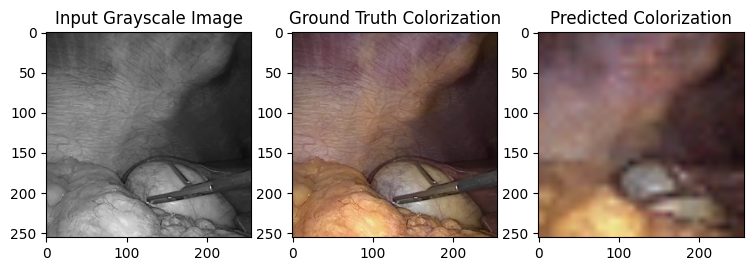


EPOCH 35 of 50

Training loss: 0.000414
Validation loss: 0.000420


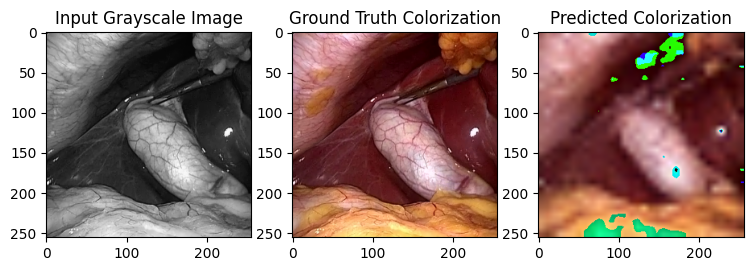


EPOCH 36 of 50

Training loss: 0.000415
Validation loss: 0.000415


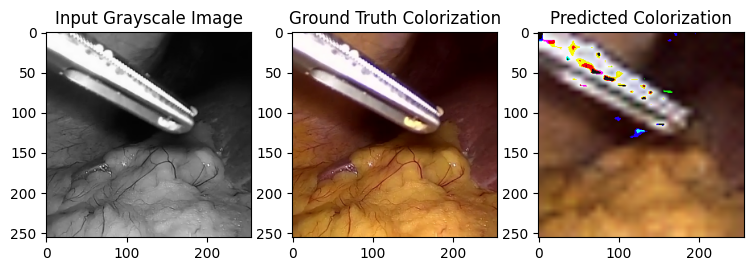


EPOCH 37 of 50

Training loss: 0.000420
Validation loss: 0.000429


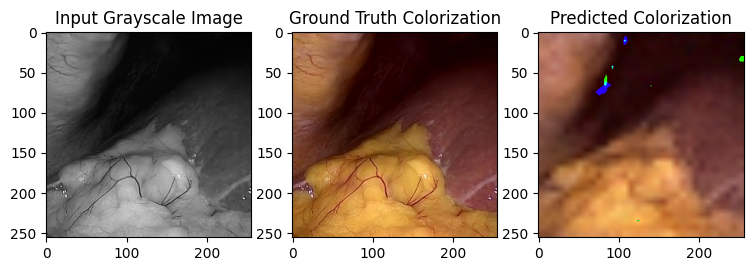


EPOCH 38 of 50

Training loss: 0.000421
Validation loss: 0.000416


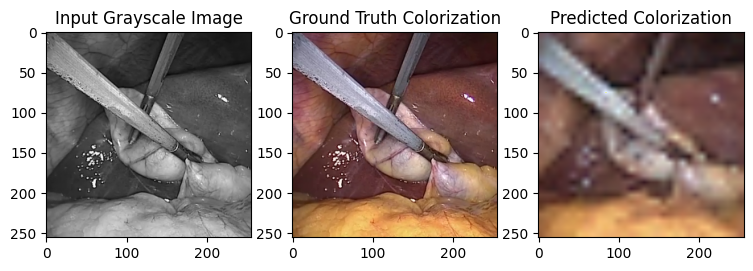


EPOCH 39 of 50

Training loss: 0.000417
Validation loss: 0.000410


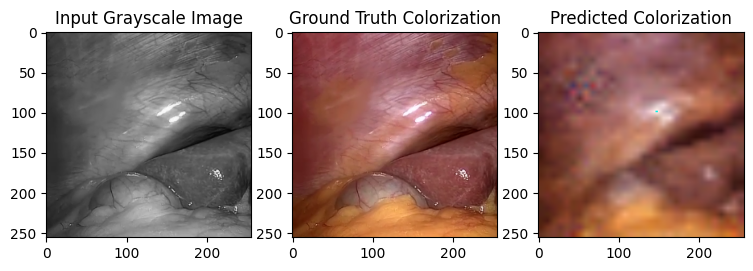


EPOCH 40 of 50

Training loss: 0.000416
Validation loss: 0.000412


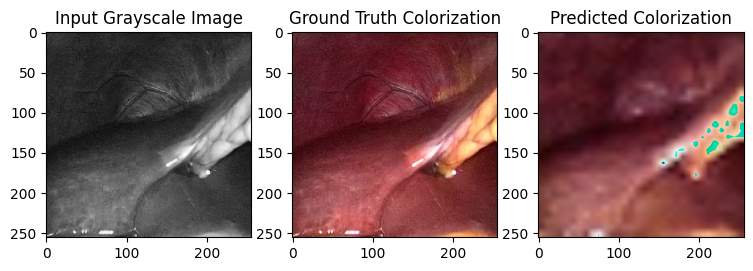


EPOCH 41 of 50

Training loss: 0.000418
Validation loss: 0.000411


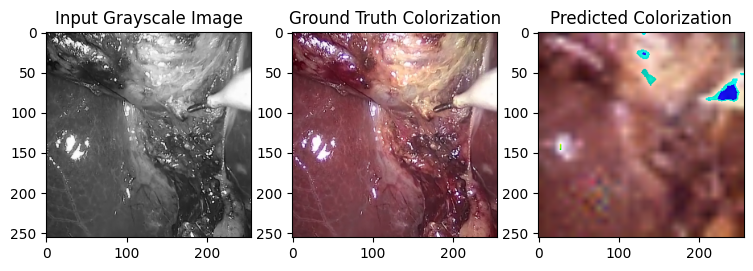


EPOCH 42 of 50

Training loss: 0.000417
Validation loss: 0.000436


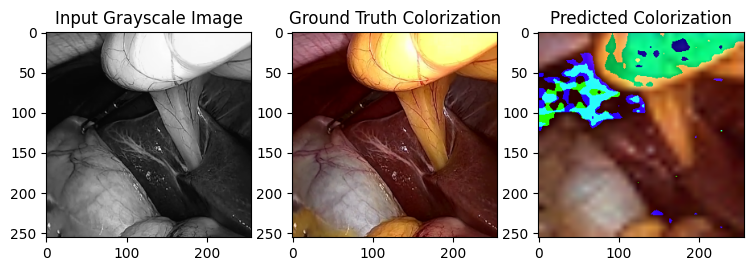


EPOCH 43 of 50

Training loss: 0.000411
Validation loss: 0.000414


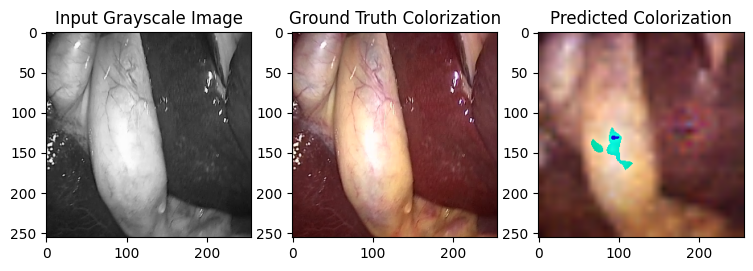


EPOCH 44 of 50

Training loss: 0.000423
Validation loss: 0.000416


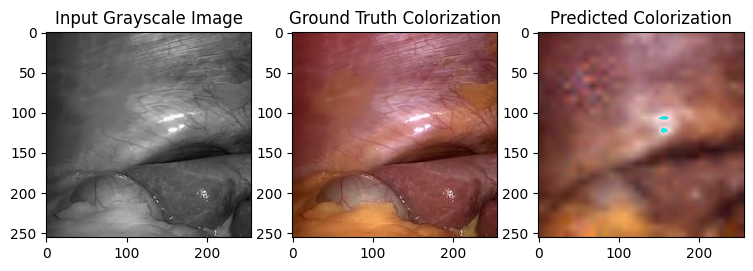


EPOCH 45 of 50

Training loss: 0.000422
Validation loss: 0.000405


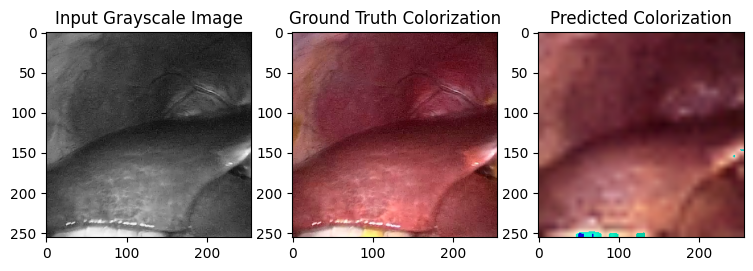


EPOCH 46 of 50

Training loss: 0.000418
Validation loss: 0.000413


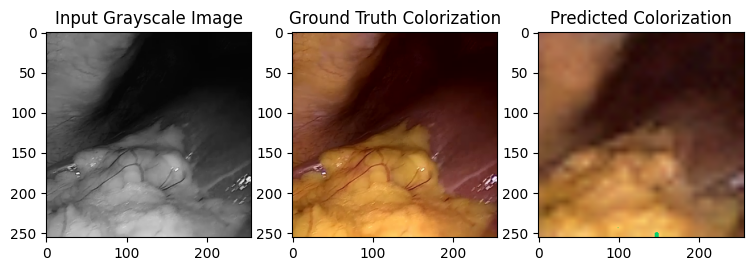


EPOCH 47 of 50

Training loss: 0.000426
Validation loss: 0.000414


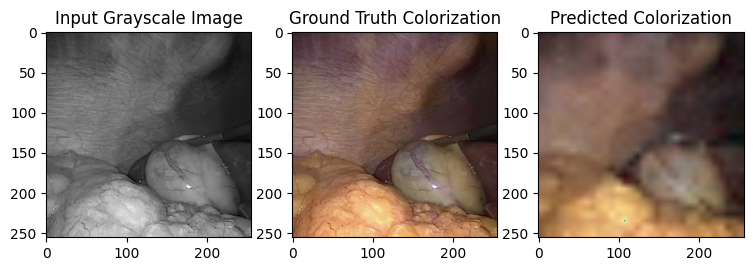


EPOCH 48 of 50

Training loss: 0.000418
Validation loss: 0.000416


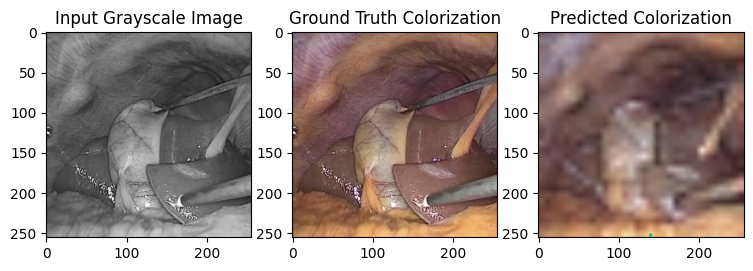


EPOCH 49 of 50

Training loss: 0.000419
Validation loss: 0.000414


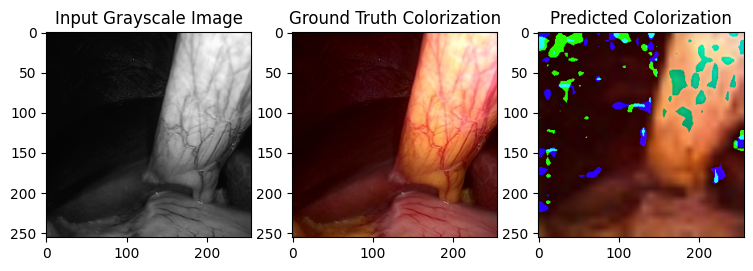


EPOCH 50 of 50

Training loss: 0.000412
Validation loss: 0.000414


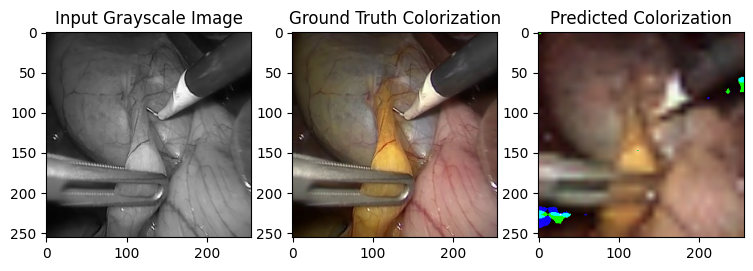

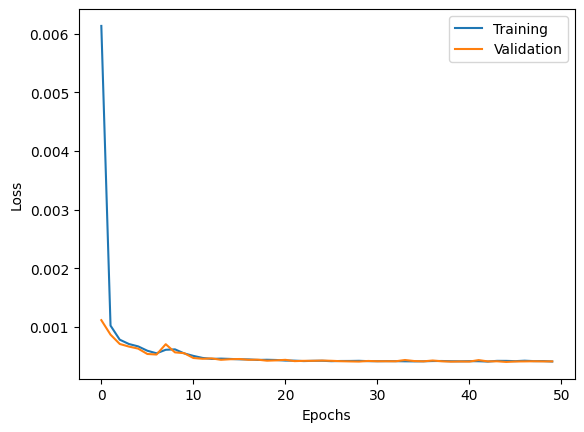

In [ ]:
train(model, loss_f, optimizer, scheduler, train_dataloader, val_dataloader, epochs=epochs, use_gpu=use_gpu)

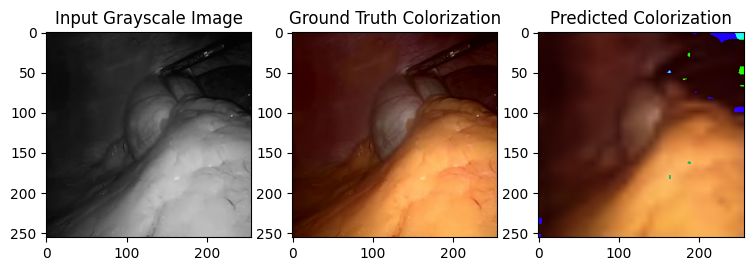

In [ ]:
visualize_predictions(test_dataloader, model, n_batches=1, use_gpu=use_gpu, mode="test")

In [ ]:
# torch.save(model, "/content/gdrive/MyDrive/Deep_Learning/saved_models/models/deep_lab_image_recolorization.pt")
torch.save(model, "/content/gdrive/MyDrive/Notes/Spring 2023/Deep Learning/Deep_Learning/saved_models/models/deep_lab_image_recolorization.pt") #Shreya


## FCN

In [ ]:
n_classes = 3
lr = 0.001
epochs = 50

model = torchvision.models.segmentation.fcn_resnet50()
model.classifier[4] = nn.Conv2d(512, n_classes, kernel_size=1, stride=1)

if use_gpu:
  model = model.cuda()

for m in model.modules():
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    if m.bias is not None:
      m.bias.data.zero_()

print(model.parameters)

loss_f = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 383MB/s]


<bound method Module.parameters of FCN(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=T

Start Training...

EPOCH 1 of 50



/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


Training loss: 0.015405
Validation loss: 0.002054


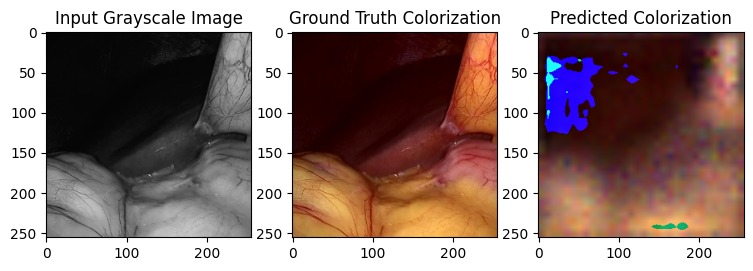


EPOCH 2 of 50

Training loss: 0.001648
Validation loss: 0.001454


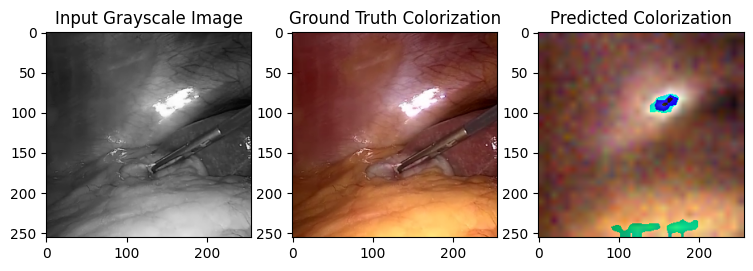


EPOCH 3 of 50

Training loss: 0.001374
Validation loss: 0.001257


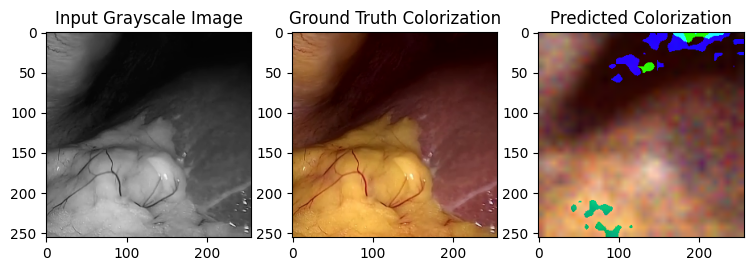


EPOCH 4 of 50

Training loss: 0.001219
Validation loss: 0.001123


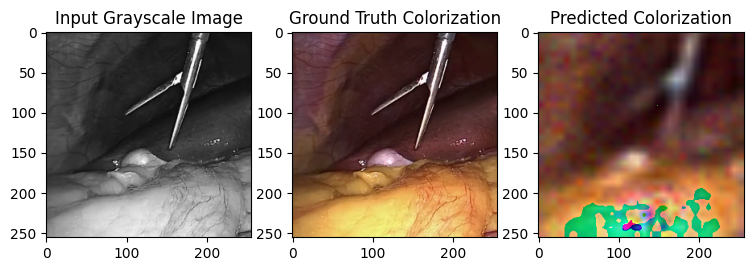


EPOCH 5 of 50

Training loss: 0.001108
Validation loss: 0.001007


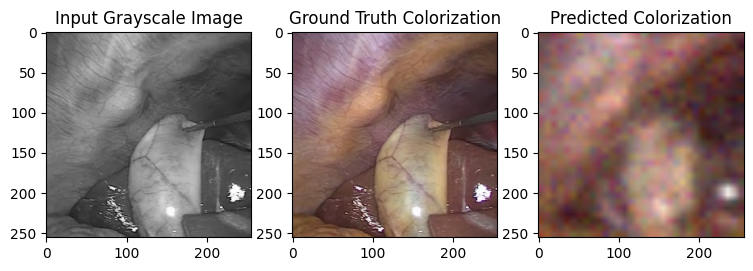


EPOCH 6 of 50

Training loss: 0.000991
Validation loss: 0.001056


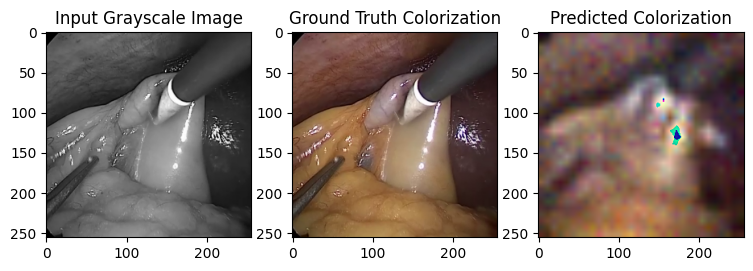


EPOCH 7 of 50

Training loss: 0.000950
Validation loss: 0.000913


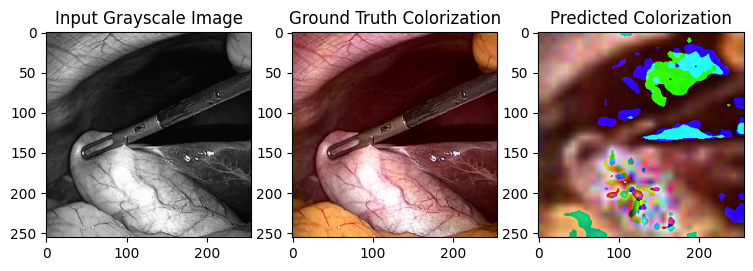


EPOCH 8 of 50

Training loss: 0.000893
Validation loss: 0.000816


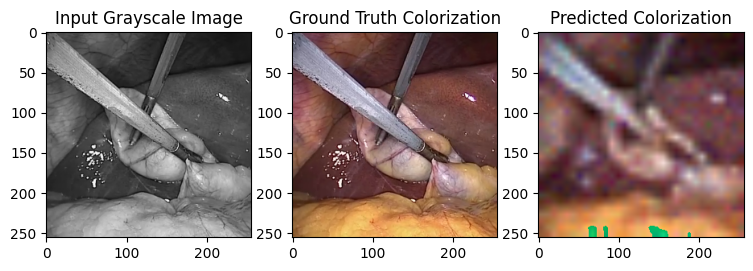


EPOCH 9 of 50

Training loss: 0.000799
Validation loss: 0.000758


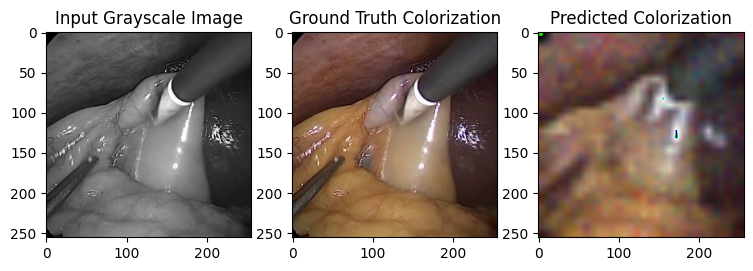


EPOCH 10 of 50

Training loss: 0.000801
Validation loss: 0.000776


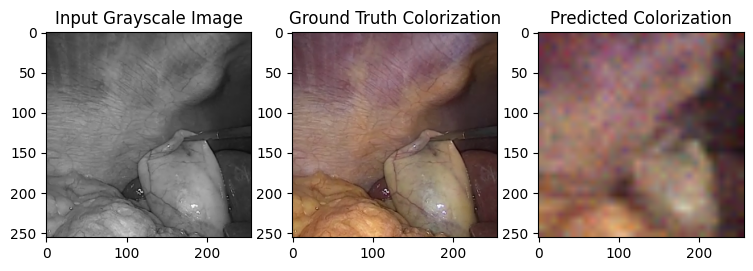


EPOCH 11 of 50

Training loss: 0.000667
Validation loss: 0.000637


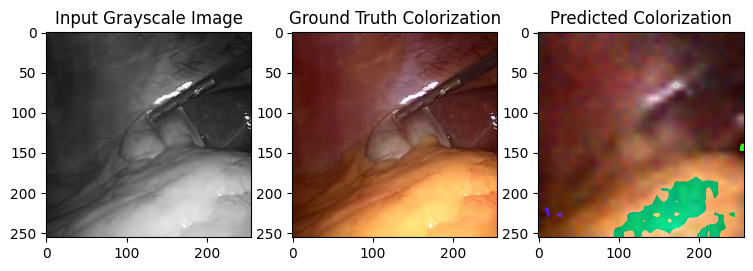


EPOCH 12 of 50

Training loss: 0.000635
Validation loss: 0.000641


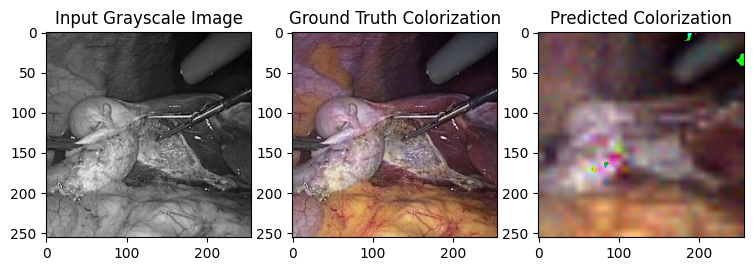


EPOCH 13 of 50

Training loss: 0.000632
Validation loss: 0.000647


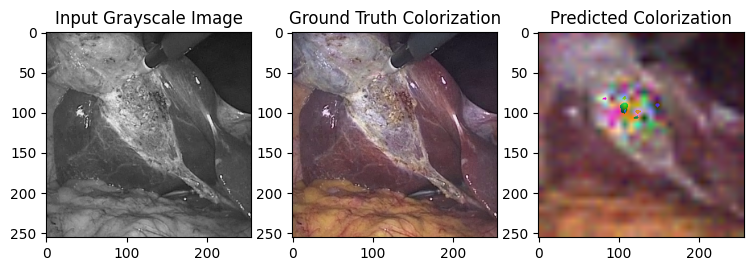


EPOCH 14 of 50

Training loss: 0.000623
Validation loss: 0.000640


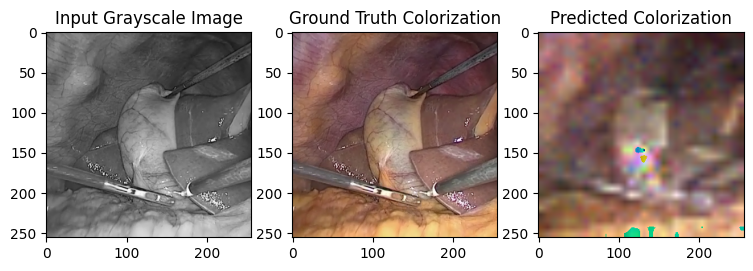


EPOCH 15 of 50

Training loss: 0.000609
Validation loss: 0.000608


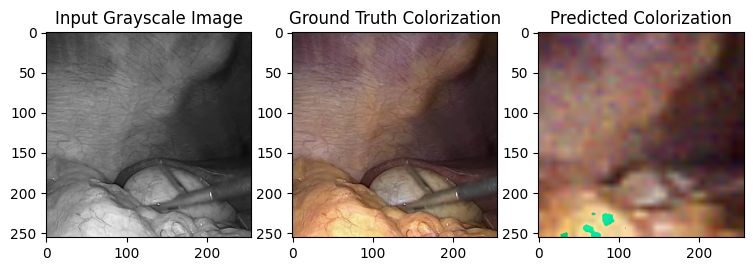


EPOCH 16 of 50

Training loss: 0.000607
Validation loss: 0.000611


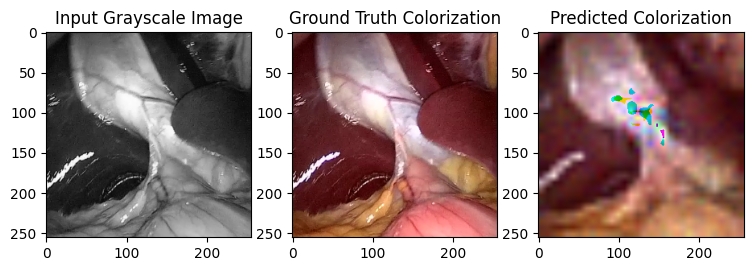


EPOCH 17 of 50

Training loss: 0.000606
Validation loss: 0.000632


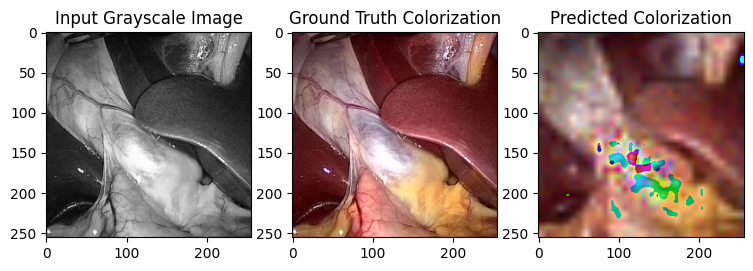


EPOCH 18 of 50

Training loss: 0.000605
Validation loss: 0.000599


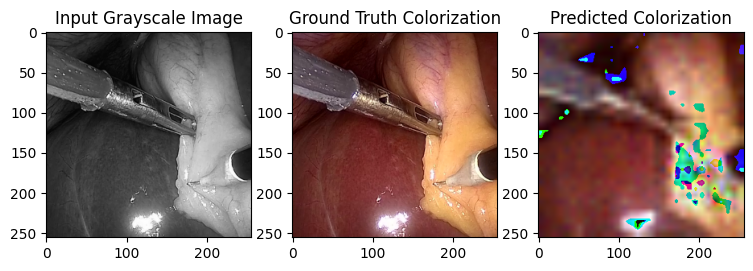


EPOCH 19 of 50

Training loss: 0.000580
Validation loss: 0.000598


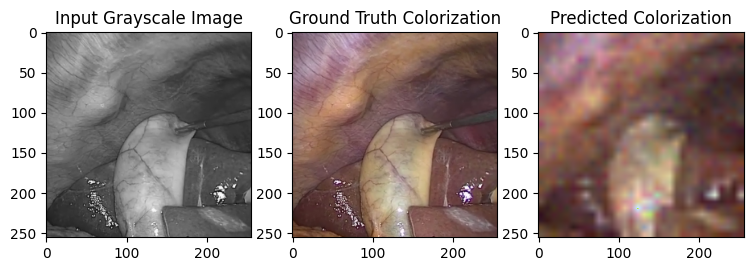


EPOCH 20 of 50

Training loss: 0.000581
Validation loss: 0.000577


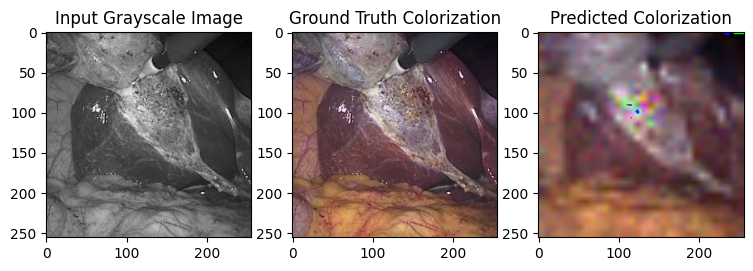


EPOCH 21 of 50

Training loss: 0.000559
Validation loss: 0.000570


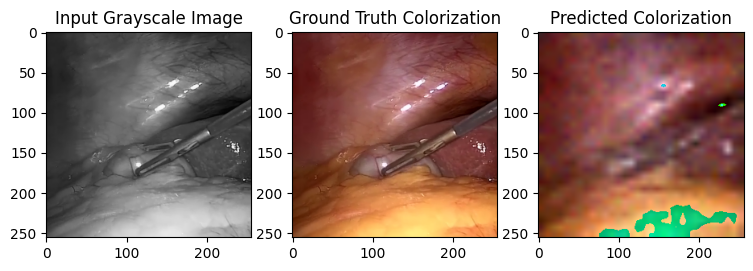


EPOCH 22 of 50

Training loss: 0.000570
Validation loss: 0.000565


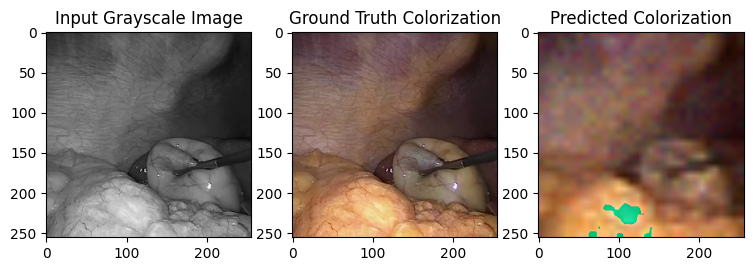


EPOCH 23 of 50

Training loss: 0.000568
Validation loss: 0.000586


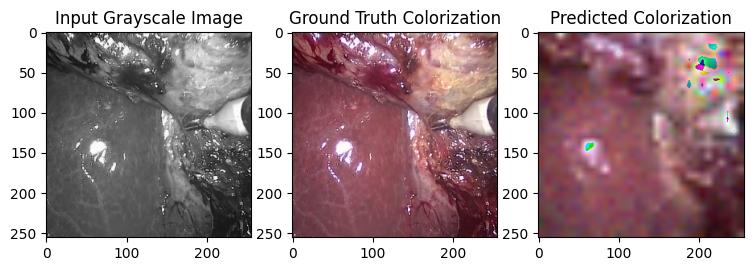


EPOCH 24 of 50

Training loss: 0.000559
Validation loss: 0.000571


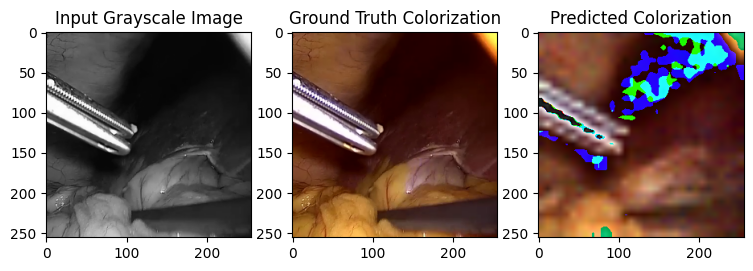


EPOCH 25 of 50

Training loss: 0.000565
Validation loss: 0.000583


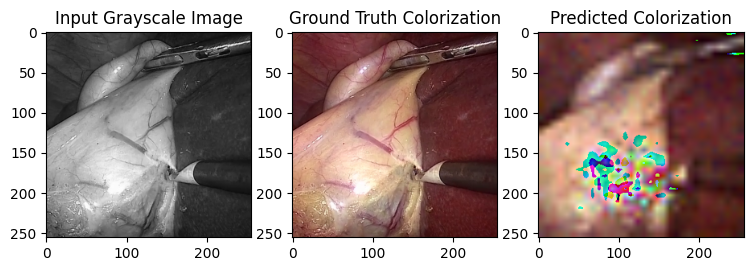


EPOCH 26 of 50

Training loss: 0.000560
Validation loss: 0.000581


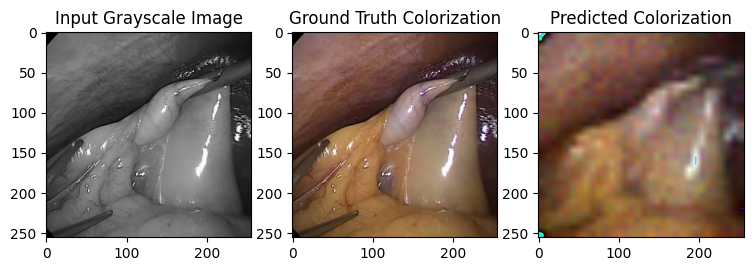


EPOCH 27 of 50

Training loss: 0.000561
Validation loss: 0.000565


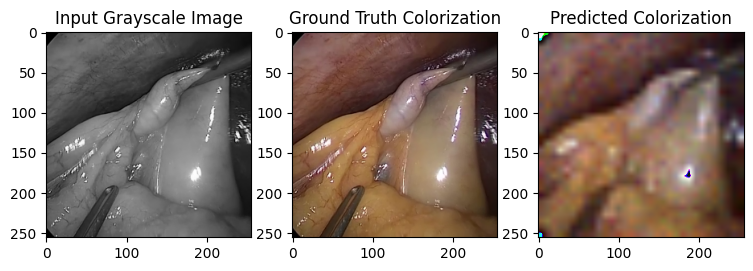


EPOCH 28 of 50

Training loss: 0.000560
Validation loss: 0.000564


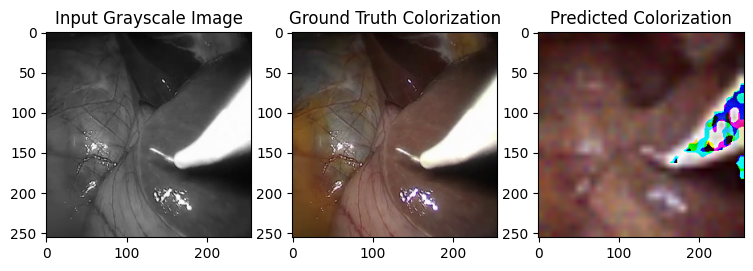


EPOCH 29 of 50

Training loss: 0.000560
Validation loss: 0.000569


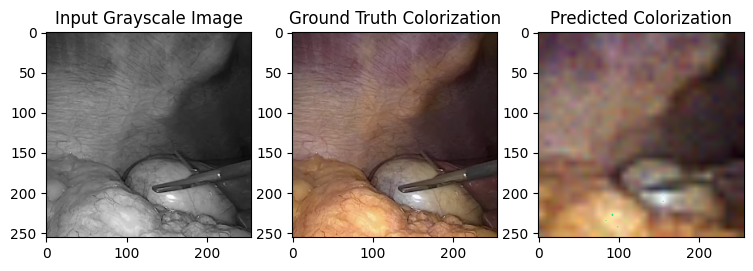


EPOCH 30 of 50

Training loss: 0.000558
Validation loss: 0.000555


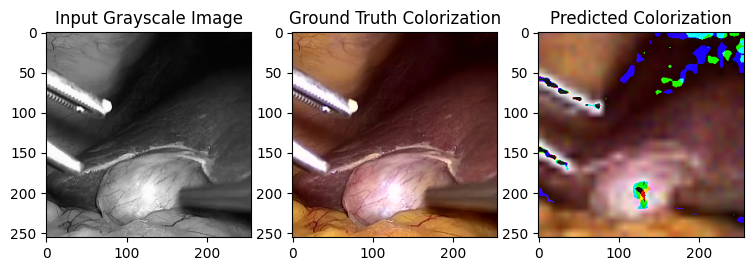


EPOCH 31 of 50

Training loss: 0.000556
Validation loss: 0.000570


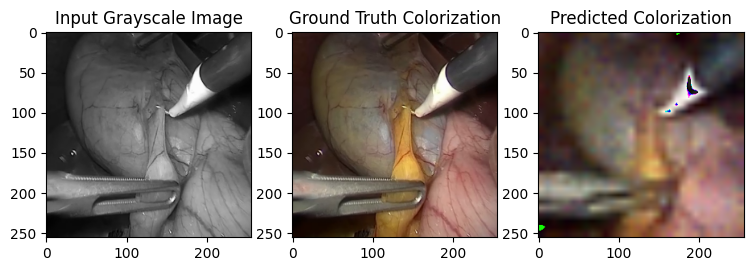


EPOCH 32 of 50

Training loss: 0.000558
Validation loss: 0.000571


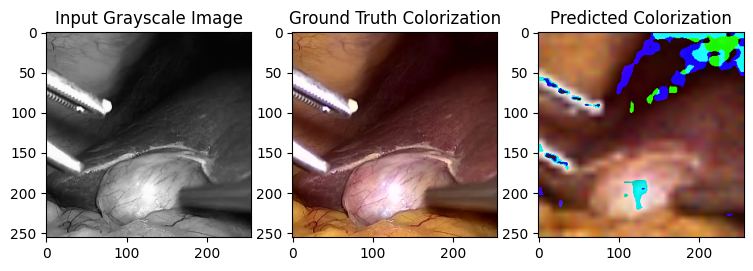


EPOCH 33 of 50

Training loss: 0.000555
Validation loss: 0.000564


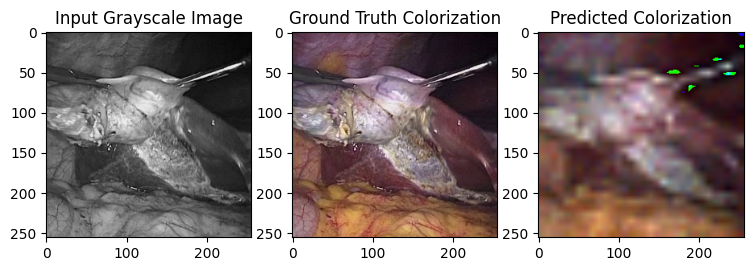


EPOCH 34 of 50

Training loss: 0.000553
Validation loss: 0.000568


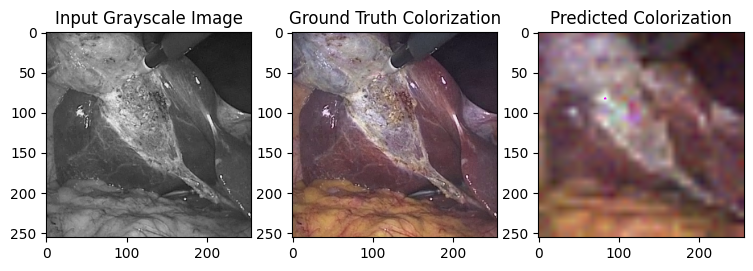


EPOCH 35 of 50

Training loss: 0.000556
Validation loss: 0.000560


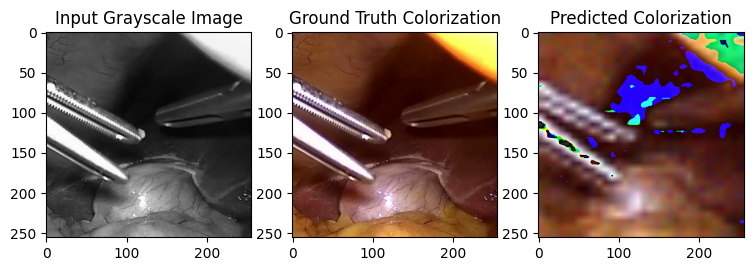


EPOCH 36 of 50

Training loss: 0.000559
Validation loss: 0.000579


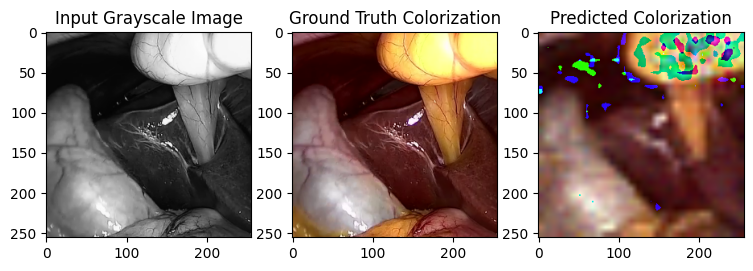


EPOCH 37 of 50

Training loss: 0.000559
Validation loss: 0.000574


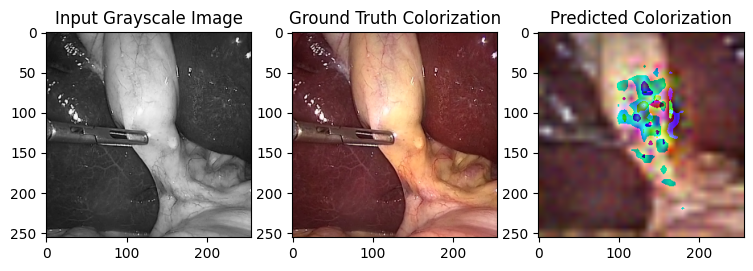


EPOCH 38 of 50

Training loss: 0.000550
Validation loss: 0.000562


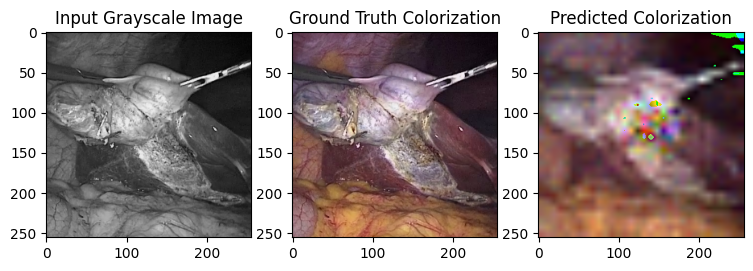


EPOCH 39 of 50

Training loss: 0.000551
Validation loss: 0.000575


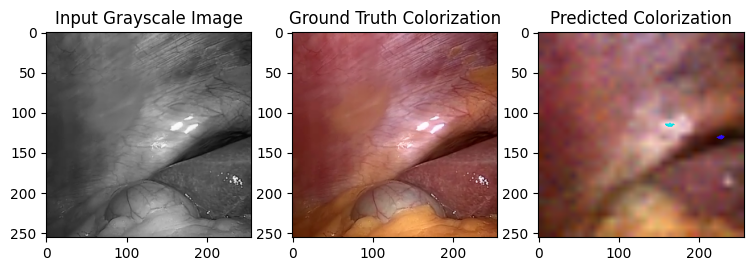


EPOCH 40 of 50

Training loss: 0.000552
Validation loss: 0.000562


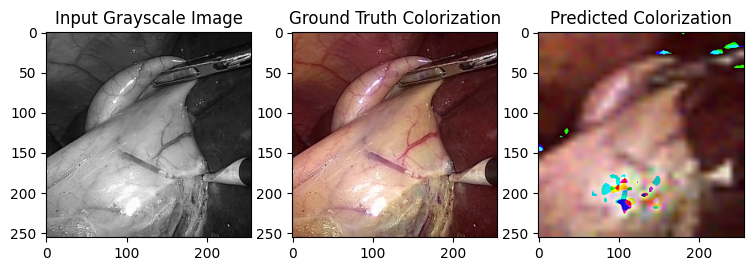


EPOCH 41 of 50

Training loss: 0.000555
Validation loss: 0.000566


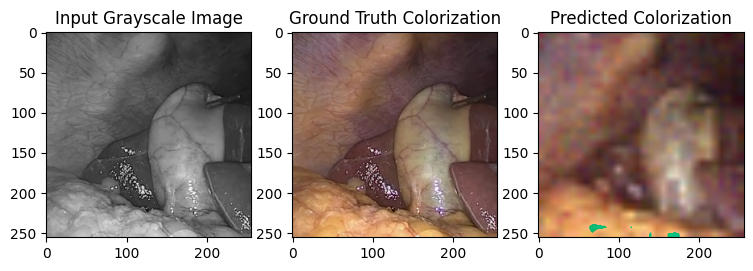


EPOCH 42 of 50

Training loss: 0.000554
Validation loss: 0.000563


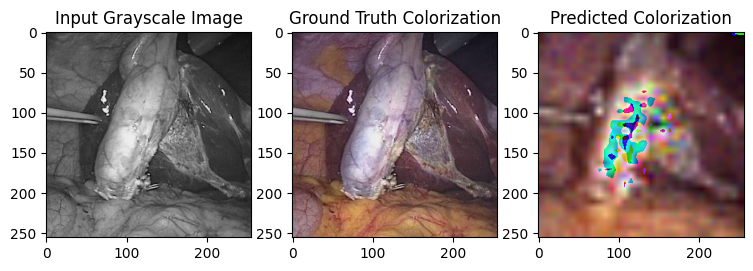


EPOCH 43 of 50

Training loss: 0.000553
Validation loss: 0.000567


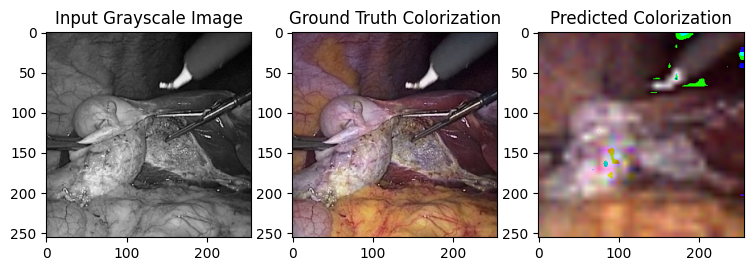


EPOCH 44 of 50

Training loss: 0.000551
Validation loss: 0.000572


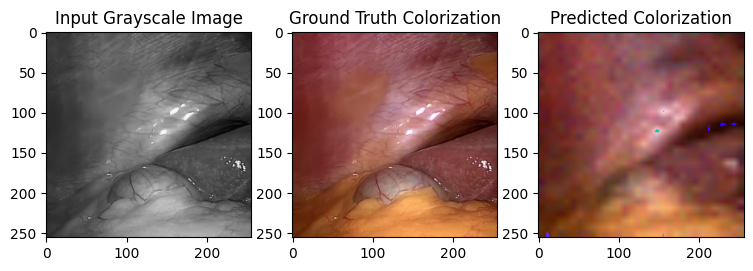


EPOCH 45 of 50

Training loss: 0.000549
Validation loss: 0.000556


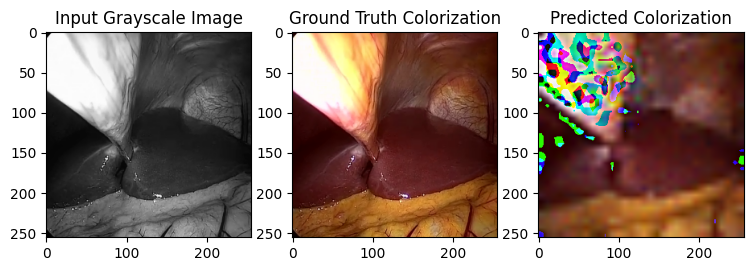


EPOCH 46 of 50

Training loss: 0.000555
Validation loss: 0.000559


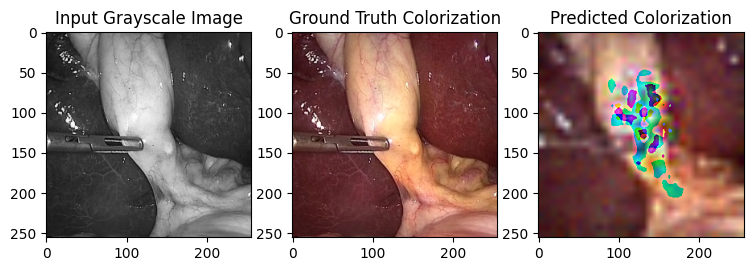


EPOCH 47 of 50

Training loss: 0.000555
Validation loss: 0.000564


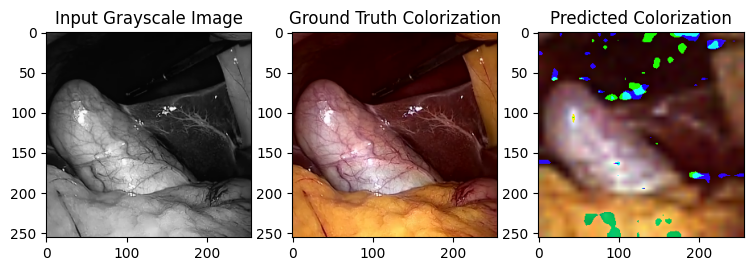


EPOCH 48 of 50

Training loss: 0.000551
Validation loss: 0.000566


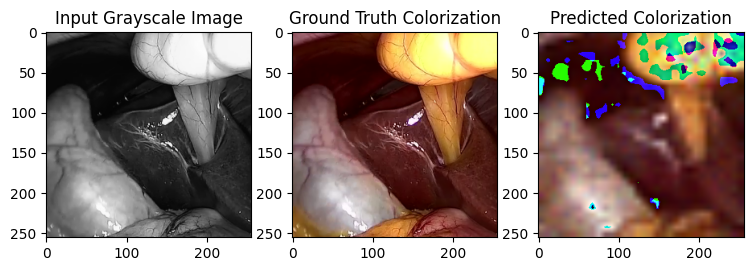


EPOCH 49 of 50

Training loss: 0.000551
Validation loss: 0.000573


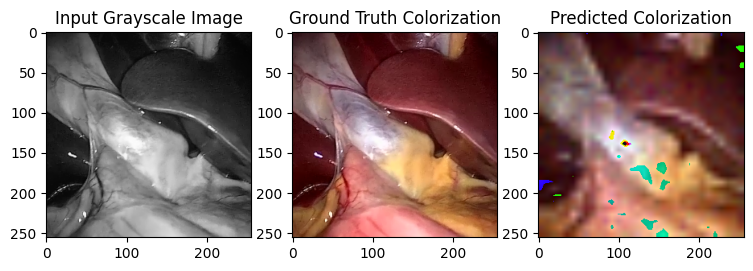


EPOCH 50 of 50

Training loss: 0.000553
Validation loss: 0.000565


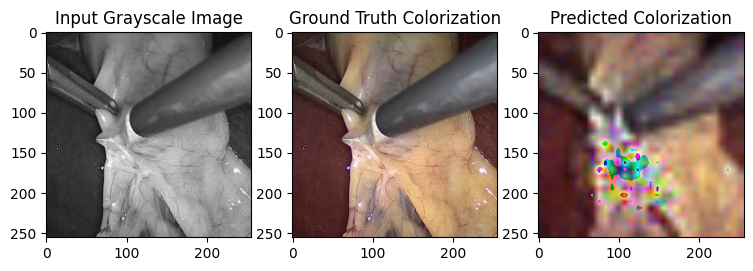

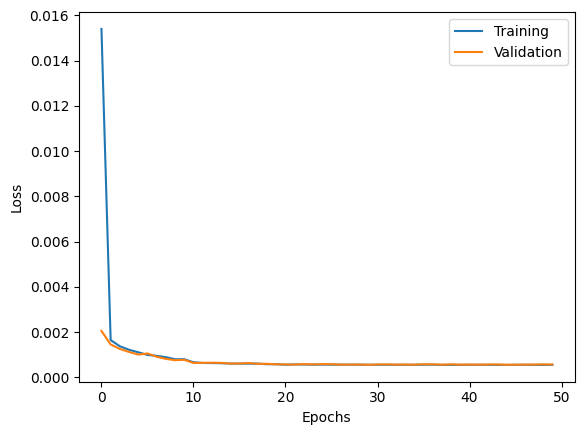

In [ ]:
train(model, loss_f, optimizer, scheduler, train_dataloader, val_dataloader, epochs=epochs, use_gpu=use_gpu)

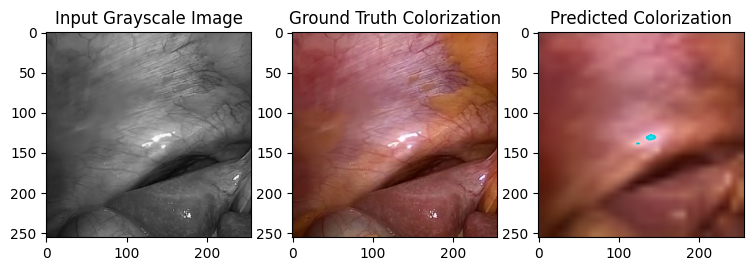

In [ ]:
visualize_predictions(test_dataloader, model, n_batches=1, use_gpu=use_gpu, mode="test")

In [ ]:
torch.save(model, "/content/gdrive/MyDrive/Deep_Learning/saved_models/models/fcn_image_recolorization.pt")

## Evaluate each of the Models

In [ ]:
def eval_test(model, loss_f, test_dataloader, use_gpu=False):
  model.eval()

  with torch.no_grad():
    test_loss = 0
    test_total = 0
    for inputs, targets in test_dataloader:
      if use_gpu:
        inputs = inputs.cuda()
        targets = targets.cuda()

      predictions = model(inputs)
      if (not isinstance(model, UNET)):
        predictions = predictions['out']
      
      test_loss += loss_f.forward(predictions, targets).item()
      test_total += targets.shape[0]

    print("Test loss: %f" % (test_loss / test_total))

In [ ]:
loss_f = nn.MSELoss()

### UNET

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


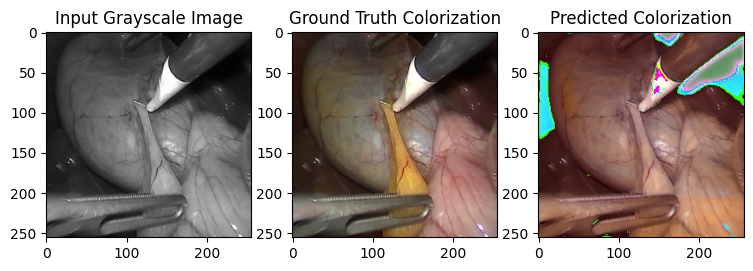

Test loss: 0.010777


In [ ]:
# unet = torch.load("/content/gdrive/MyDrive/Deep_Learning/saved_models/models/unet_image_recolorization.pt")
unet = torch.load("/content/gdrive/MyDrive/Notes/Spring 2023/Deep Learning/Deep_Learning/saved_models/models/unet_image_recolorization.pt") #Shreya


visualize_predictions(test_dataloader, unet, n_batches=1, use_gpu=use_gpu, mode="test")
eval_test(unet, loss_f, test_dataloader, use_gpu=use_gpu)

### Deep Lab V3

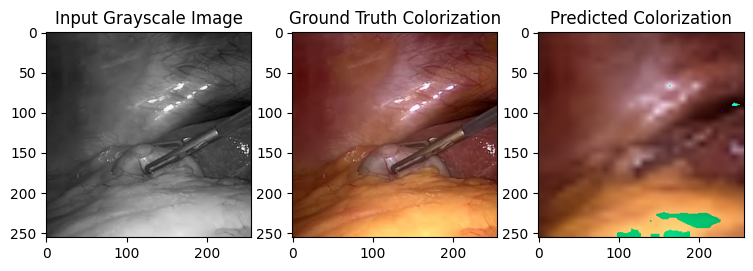

Test loss: 0.011712


In [ ]:
# deep_lab = torch.load("/content/gdrive/MyDrive/Deep_Learning/saved_models/models/deep_lab_image_recolorization.pt")
deep_lab = torch.load("/content/gdrive/MyDrive/Notes/Spring 2023/Deep Learning/Deep_Learning/saved_models/models/deep_lab_image_recolorization.pt") #Shreya


visualize_predictions(test_dataloader, deep_lab, n_batches=1, use_gpu=use_gpu, mode="test")
eval_test(deep_lab, loss_f, test_dataloader, use_gpu=use_gpu)

### FCN

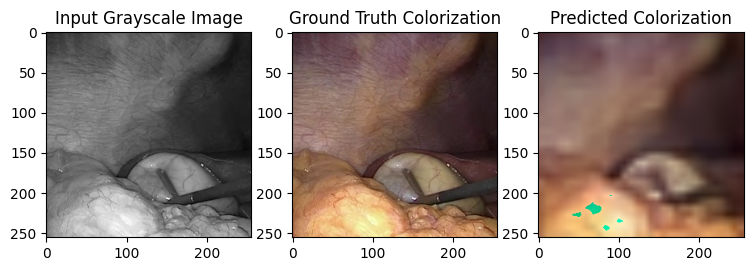

Test loss: 0.003671


In [ ]:
fcn = torch.load("/content/gdrive/MyDrive/Deep_Learning/saved_models/models/fcn_image_recolorization.pt")

visualize_predictions(test_dataloader, fcn, n_batches=1, use_gpu=use_gpu, mode="test")
eval_test(fcn, loss_f, test_dataloader, use_gpu=use_gpu)